In this notebook results from the benchmarking och the simulated dataset of 12.5 is displayed. 

In [1]:
import ruptures as rpt
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import pybedtools
import time

In [49]:
def calculate_avg_thr(path):
    avg_thr=[]
    data=pd.read_csv(path, header=None, sep='\t')
    #Extract the individual sample
    for i in range(len(data.columns)-2):
        curr_array=np.array(data[i+2])
        curr_array[curr_array > 150] = 150
        (n, bins, patches)=plt.hist(curr_array, bins=150)
        max_value=(np.max(n[4:]))
        max_index = np.where(n == max_value)
        avg=bins[max_index]
        avg_thr.append(avg)
    return avg_thr


#Creates a bed file from an array
def create_bed_from_array(array, chr_name):

    data_array = []
    if len(array) % 2 != 0:
        array=array[:-1] #Remove last value
    for i in range(0, len(array), 2):
        data_array.append([chr_name, array[i],array[i+1]])
    np_array = np.array(data_array)
    dataframe = pd.DataFrame(np_array)
    return pybedtools.BedTool.from_dataframe(dataframe)


#Removes matches with a 60% match
def remove_artifacts(ref_bed, ind_bed):
    ind5_bkps_bed = pybedtools.BedTool(ind_bed)
    ref_bkps_bed = pybedtools.BedTool(ref_bed)
    return ind5_bkps_bed.subtract(ref_bkps_bed, f=0.6, r=True, A=True )#

def bed_to_array(bed):
    return pybedtools.BedTool.to_dataframe(bed).loc[:, ["start", "end"]].to_numpy().flatten()

def filter_coverage(pred_array, coverage_array, threshold):
    pred_filterd=[]
    for i in range(len(pred_array)-1):
        start=pred_array[i]
        stop=pred_array[i+1]
        temp=coverage_array[start: stop]
        avg_coverage=sum(temp)/len(temp)
       
        if avg_coverage<threshold:
            pred_filterd.extend([start, stop])
    return pred_filterd

#Creates an info array about the predicted change points
def create_info_array(bedObject):
        info=[]
        for feature in bedObject:
            info.append(feature.stop-feature.start)
        min_info=np.min(info)
        max_info=np.max(info)
        avg_info=np.mean(info)
        len_info=len(info)
        (n, bins, patches)=plt.hist(info)
        plt.xlabel('Size of deletion')
        plt.ylabel('Number of deletions')
        plt.title('Identified deletions')
        plt.show()

        return min_info, max_info, avg_info, len_info, n, bins



In [65]:
#Calculates the changepoints
def predict_deletions_bottomUp(path, chr_name, pen_ref, pen_ind, arr_avg_cov, ref_index,name, sample_index='all'):

    #Read in the data
    data=pd.read_csv(path, header=None, sep='\t')

    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"
    min_size=100

    #Extract the reference
    all_ref=[]

    #Iterate over all references
    for index in ref_index:
        threshold=arr_avg_cov[index-2]*0.35
        avg_cutoff=arr_avg_cov[index-2]*3
        reference=np.array(data[index])
        reference[reference > avg_cutoff] = avg_cutoff
        t0 = time.time()
        algo_ref = rpt.BottomUp(model=model, min_size=min_size).fit(reference)
        ref_bkps = algo_ref.predict(pen=pen_ref)
        t1 = time.time()
        
    
        filter_array_ref=filter_coverage(ref_bkps, reference, threshold) #Filter the reference
        all_ref.extend(filter_array_ref)
        
        rpt.display(reference, filter_array_ref, figsize=(100, 6))
        plt.title('Reference ' + str(index))
        plt.xlabel('Position')
        plt.ylabel('Coverage')
        plt.xticks(np.arange(0, len(reference)+1, 100000))
        plt.show()
     #   plt.savefig('results_benchmarking/reference_'+ str(index) + name+'.png')

    ref_bed=create_bed_from_array(all_ref, chr_name) #create bed file and save it
    ref_bed_sort=ref_bed.sort().merge().saveas("results_benchmarking/reference_"+name+".bed")

    #Extract the individual sample
    if sample_index=='all': #If 'all' is specifed, the predictions will be done for all columns
        sample_index=range(2, len(data.columns))

    for i in sample_index:

        if i not in ref_index:
            threshold=arr_avg_cov[i-2]*0.15
            avg_cutoff=arr_avg_cov[i-2]*3
            individual=np.array(data[i])
            individual[individual > avg_cutoff] =avg_cutoff

            #Fit the data
            t0 = time.time()
            algo = rpt.BottomUp(model=model, min_size=min_size).fit(individual)

            #Predict the breakpoints for the individual and reference
            ind_bkps = algo.predict(pen=pen_ind)
            t1 = time.time()
            print("Sample:" + str(i) + ', running time: ')
            print(t1-t0)

            
            #filter the sample
            filter_array=filter_coverage(ind_bkps, individual,threshold)
            rpt.display(individual, filter_array, figsize=(100, 6))
            plt.title('Sample ' + str(i))
            plt.xlabel('Position')
            plt.ylabel('Coverage')
            plt.xticks(np.arange(0, len(individual)+1, 100000))
            plt.show()

            pred_filtred_bed=create_bed_from_array(filter_array, chr_name) #create bed file

           # Remove artifacts from reference
            rem_bed=remove_artifacts(ref_bed_sort,pred_filtred_bed).saveas("results_benchmarking/sample_" + str(i) + "_"+name+".bed") # save it
            
          
            #roc_curve(12.5, ind_bkps, true_bkps_bed, individual_12_5x, ref_bkps, 1000000)
            display_over_under_est(true_bkps_dict[str(i)], rem_bed, 1000000)
            
            
            

In [80]:
#Calculates the changepoints
def predict_deletions_window(path, chr_name, pen_ref, pen_ind,width,  arr_avg_cov, ref_index,name, sample_index='all'):

    #Read in the data
    data=pd.read_csv(path, header=None, sep='\t')

    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"
    min_size=100

    #Extract the reference
    all_ref=[]

    #Iterate over all references
    for index in ref_index:
        threshold=arr_avg_cov[index-2]*0.75
        avg_cutoff=arr_avg_cov[index-2]*3
        reference=np.array(data[index])
        reference[reference > avg_cutoff] = avg_cutoff
        t0 = time.time()
        algo_ref = rpt.Window(width=width, model=model, min_size=min_size).fit(reference)
        ref_bkps = algo_ref.predict(pen=pen_ref)
        t1 = time.time()
        
    
        filter_array_ref=filter_coverage(ref_bkps, reference, threshold) #Filter the reference
        all_ref.extend(filter_array_ref)
        
        rpt.display(reference, filter_array_ref, figsize=(100, 6))
        plt.title('Reference ' + str(index))
        plt.xlabel('Position')
        plt.ylabel('Coverage')
        plt.xticks(np.arange(0, len(reference)+1, 100000))
        plt.show()
     #   plt.savefig('results_benchmarking/reference_'+ str(index) + name+'.png')

    ref_bed=create_bed_from_array(all_ref, chr_name) #create bed file and save it
    ref_bed_sort=ref_bed.sort().merge().saveas("results_benchmarking/reference_"+name+".bed")

    #Extract the individual sample
    if sample_index=='all': #If 'all' is specifed, the predictions will be done for all columns
        sample_index=range(2, len(data.columns))

    for i in sample_index:

        if i not in ref_index:
            threshold=arr_avg_cov[i-2]*0.75
            print(threshold)
            avg_cutoff=arr_avg_cov[i-2]*3
            individual=np.array(data[i])
            individual[individual > avg_cutoff] =avg_cutoff

            #Fit the data
            t0 = time.time()
            algo = rpt.Window(width=width,model=model, min_size=min_size).fit(individual)

            #Predict the breakpoints for the individual and reference
            ind_bkps = algo.predict(pen=pen_ind)
            t1 = time.time()
            print("Sample:" + str(i) + ', running time: ')
            print(t1-t0)

            
            #filter the sample
            filter_array=filter_coverage(ind_bkps, individual,threshold)
            rpt.display(individual, filter_array, figsize=(100, 6))
            plt.title('Sample ' + str(i))
            plt.xlabel('Position')
            plt.ylabel('Coverage')
            plt.xticks(np.arange(0, len(individual)+1, 100000))
            plt.show()

            pred_filtred_bed=create_bed_from_array(filter_array, chr_name) #create bed file

           # Remove artifacts from reference
            rem_bed=remove_artifacts(ref_bed_sort,pred_filtred_bed).saveas("results_benchmarking/sample_" + str(i) + "_"+name+".bed") # save it
            
          
            #roc_curve(12.5, ind_bkps, true_bkps_bed, individual_12_5x, ref_bkps, 1000000)
            display_over_under_est(true_bkps_dict[str(i)], rem_bed, 1000000)
            
            
            

In [98]:
#Calculates the changepoints
def predict_deletions_pelt(path, chr_name, pen_ref, pen_ind,jump,  arr_avg_cov, ref_index,name, sample_index='all'):

    #Read in the data
    data=pd.read_csv(path, header=None, sep='\t')

    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"
    min_size=100

    #Extract the reference
    all_ref=[]

    #Iterate over all references
    for index in ref_index:
        threshold=arr_avg_cov[index-2]*0.35
        avg_cutoff=arr_avg_cov[index-2]*3
        reference=np.array(data[index])
        reference[reference > avg_cutoff] = avg_cutoff
        t0 = time.time()
        algo_ref = rpt.Pelt(model=model, min_size=min_size, jump=jump).fit(reference)
        ref_bkps = algo_ref.predict(pen=pen_ref)
        t1 = time.time()
        
    
        filter_array_ref=filter_coverage(ref_bkps, reference, threshold) #Filter the reference
        all_ref.extend(filter_array_ref)
        
        rpt.display(reference, filter_array_ref, figsize=(100, 6))
        plt.title('Reference ' + str(index))
        plt.xlabel('Position')
        plt.ylabel('Coverage')
        plt.xticks(np.arange(0, len(reference)+1, 100000))
        plt.show()
     #   plt.savefig('results_benchmarking/reference_'+ str(index) + name+'.png')

    ref_bed=create_bed_from_array(all_ref, chr_name) #create bed file and save it
    ref_bed_sort=ref_bed.sort().merge().saveas("results_benchmarking/reference_"+name+".bed")

    #Extract the individual sample
    if sample_index=='all': #If 'all' is specifed, the predictions will be done for all columns
        sample_index=range(2, len(data.columns))

    for i in sample_index:

        if i not in ref_index:
            threshold=arr_avg_cov[i-2]*0.15
            print(threshold)
            avg_cutoff=arr_avg_cov[i-2]*3
            individual=np.array(data[i])
            individual[individual > avg_cutoff] =avg_cutoff

            #Fit the data
            t0 = time.time()
            algo = rpt.Pelt(model=model, min_size=min_size, jump=jump).fit(individual)

            #Predict the breakpoints for the individual and reference
            ind_bkps = algo.predict(pen=pen_ind)
            t1 = time.time()
            print("Sample:" + str(i) + ', running time: ')
            print(t1-t0)

            
            #filter the sample
            filter_array=filter_coverage(ind_bkps, individual,threshold)
            rpt.display(individual, filter_array, figsize=(100, 6))
            plt.title('Sample ' + str(i))
            plt.xlabel('Position')
            plt.ylabel('Coverage')
            plt.xticks(np.arange(0, len(individual)+1, 100000))
            plt.show()

            pred_filtred_bed=create_bed_from_array(filter_array, chr_name) #create bed file

           # Remove artifacts from reference
            rem_bed=remove_artifacts(ref_bed_sort,pred_filtred_bed).saveas("results_benchmarking/sample_" + str(i) + "_"+name+".bed") # save it
            
          
            #roc_curve(12.5, ind_bkps, true_bkps_bed, individual_12_5x, ref_bkps, 1000000)
            display_over_under_est(true_bkps_dict[str(i)], rem_bed, 1000000)
            
            
            

In [50]:
# Make a python function which can compare output from script to the given .bed files and calculate:

# Accuracy = (TP+TN)(/TN+FN+TP+FP)
# Sensitivity (True Positive Rate) = TP/(TP+FN)
# Specificity (True Positive Rate) = TN/(FP+TN)
# ROC-curve

# True Positive - A true deletion (found through script and bed file)
# False Positive - Script find deletion but not in bed file (over estimated)
# True Negative - Icke deletion (interval from deletion to deletion)
# False Negative - Script does not find true deletion (missed sites)

# Find the smallest deletion (true positive with the smallest length)

def calc_acc_sens_spec(pred_bkps_bed, true_bkps_bed, lenght):
   # Compare 2 bed-files or two arrays or matrices
   # pred_bed is from our script
   # true_bed is bed-file with true deletions

   # pred_bkps_bed = pybedtools.BedTool(pred_bed)
   # true_bkps_bed = pybedtools.BedTool(true_bed)

    true_pos_bed= pred_bkps_bed.intersect(true_bkps_bed)
    false_pos_bed=pred_bkps_bed.subtract(true_bkps_bed)

    true_pos_arr=[]
    false_pos_arr=[]
    real_del=[]

    for feature in true_pos_bed:
        true_pos_arr.append(feature.stop-feature.start)
    for feature in false_pos_bed:
        false_pos_arr.append(feature.stop-feature.start)
    for feature in true_bkps_bed:
        real_del.append(feature.stop-feature.start)

   # True positives
    true_pos = sum(true_pos_arr)
   # False positives
    false_pos =  sum(false_pos_arr)
   # False negative
    false_neg = sum(real_del)- sum(true_pos_arr)#Real deletions - true positives
   # True negative
    true_neg = lenght - sum(false_pos_arr) - false_neg - sum(true_pos_arr)


    accuracy = (true_pos + true_neg)/(true_neg + false_neg + true_pos + false_pos)
    sensitivity = true_pos/(true_pos + false_neg)
    specificity = true_neg/(true_neg + false_pos)

    return accuracy, sensitivity, specificity

def over_estimated_sites(true_del, false_pos):
    over_est_sites = []
    real_del=[]
    # Loop through size/number of true deletions
    for i in range(true_del.shape[0]):
        real_del.append(true_del.loc[i,"end"]-true_del.loc[i,"start"])
        left_over_est = 0 # Over estimation to the left of the deletion
        right_over_est = 0 # Over estimation to the right of the deletion
        # Loop through all false positives
        for j in range(false_pos.shape[0]):
            # Left side match
            if false_pos.loc[j,"end"] == true_del.loc[i,"start"]:
                left_over_est = false_pos.loc[j,"end"]-false_pos.loc[j,"start"]
            # Right side match
            elif false_pos.loc[j,"start"] == true_del.loc[i,"end"]:
                right_over_est = false_pos.loc[j,"end"]-false_pos.loc[j,"start"]
        over_est_sites.append(left_over_est + right_over_est) # Append number of over estimated sites

    fractions = [(i / j)*100 for i, j in zip(over_est_sites, real_del)]
    my_labels = {"x1" : "No over estimation", "x2" : "Completly missed", "x3":"Partly over estimated"}

    for k in range(len(fractions)):
        if fractions[k]==0:
            plt.scatter(real_del[k], fractions[k], c="g", label=my_labels["x1"])
            my_labels["x1"] = "_nolegend_"
        elif fractions[k]==-1:
            plt.scatter(real_del[k], fractions[k], c="r", label=my_labels["x2"])
            my_labels["x2"] = "_nolegend_"
        else:
            plt.scatter(real_del[k], fractions[k], c="b", label=my_labels["x3"])
            my_labels["x3"] = "_nolegend_"


    plt.title("Percentage Over Estimated Sites")
    plt.xlabel("Size of deletion")
    plt.ylabel("% over estimated sites")
    plt.legend()
    plt.grid()
    plt.show()
    return fractions

#uses bedfile to dataframe
def under_estimated_sites(true_del, true_pos):
    missed_sites = []
    real_del=[]
    for i in range(true_del.shape[0]):
        real_del.append(true_del.loc[i,"end"]-true_del.loc[i,"start"])
        if true_del.loc[i,"name"]==0:
            missed_sites.append(true_del.loc[i,"end"]-true_del.loc[i,"start"])
        else:
            j = 0
            while true_pos.loc[j,"start"] < true_del.loc[i,"end"]:
                j=j+1
                if j >= true_pos.shape[0]:
                    break
            missed_sites.append(true_pos.loc[j-1,"start"]-true_del.loc[i,"start"] + true_del.loc[i,"end"]-true_pos.loc[j-1,"end"])

    fractions = [(i / j)*100 for i, j in zip(missed_sites, real_del)]
    my_labels = {"x1" : "Completly missed", "x2" : "Nothing missed", "x3":"Partly missed"}

    for k in range(len(fractions)):
        if fractions[k]==100:
            plt.scatter(real_del[k], fractions[k], c="r", label=my_labels["x1"])
            my_labels["x1"] = "_nolegend_"
            
        elif fractions[k]==0:
            plt.scatter(real_del[k], fractions[k], c="g", label=my_labels["x2"])
            my_labels["x2"] = "_nolegend_"
        else:
            plt.scatter(real_del[k], fractions[k], c="b", label=my_labels["x3"])
            my_labels["x3"] = "_nolegend_"
    plt.title("Percentage Under Estimated Sites")
    plt.xlabel("Size of deletion")
    plt.ylabel("% missed sites")
    plt.legend()
    plt.grid()
    plt.show()
    return fractions


def roc_curve(avg_coverage, pred_array, true_del_bed, coverage_array, ref_arr, lenght):

    threshold = np.linspace(0, avg_coverage,70)
    acc_arr = []
    spec_arr = []
    sens_arr = []
    for thr in threshold:
        # filter_arr=filter_coverage(pred_array, thr, coverage_array) #Filter some threshold
        #
        # pred_filtred_bed=create_bed_from_array(filter_arr) #create bed file
        # ref_bed=create_bed_from_array(ref_arr)
        # rem_pred_filter=remove_artifacts_window(ref_bed,pred_filtred_bed)
        rem_pred_filter=pred_breakpoints(ref_arr, pred_array, coverage_array, thr)
        accuracy, sensitivity, specificity  = calc_acc_sens_spec(rem_pred_filter, true_del_bed, lenght)
        acc_arr.append(accuracy)
        spec_arr.append(specificity)
        sens_arr.append(sensitivity)

    # print("Sensitivity: ")
    # print(sens_arr)
    # print("specificity")
    # print(spec_arr)
    # print("accuracy")
    # print(acc_arr)
    plt.figure(1)
    fpr=1-np.array(spec_arr)
    plt.plot(fpr, sens_arr)
    plt.title("ROC curve - coverage filtering thresholds ")
    plt.xlabel("False positive rate")
    plt.ylabel("Sensitivity")
    same=[]
    # returns the unique values, the index of the first occurrence of a value, and the count for each element
    vals, idx_start, count = np.unique(fpr, return_counts=True, return_index=True)
    idx_sort = np.argsort(fpr)
    # splits the indices into separate arrays
    res = np.split(idx_sort, idx_start[1:])
    index=0
    #for p in res:
        #max_p=max(p)
      #  min_p=min(p)
       # if index==0: 
       #     plt.annotate(round(threshold[min_p], 1), xy=(fpr[min_p],sens_arr[min_p]))
       #     index=1
       # else: 
       #     plt.annotate(round(threshold[min_p], 1), xy=(fpr[min_p],sens_arr[min_p]))
        #    index=0
        #else:
           
            #plt.annotate(round(threshold[max_p], 2), xy=(fpr[max_p],sens_arr[max_p])
    plt.grid()
    #plt.plot(threshold, acc_arr)
    plt.show()
    
    
    
def display_over_under_est(true_bkps_bed, rem_pred_filter, length):
    true_del_with_matches_df = true_bkps_bed.intersect(rem_pred_filter, c=True).to_dataframe()
    false_pos_df=rem_pred_filter.subtract(true_bkps_bed).to_dataframe()
    true_pos_df=rem_pred_filter.intersect(true_bkps_bed).to_dataframe()

    #Under estimated
    under_estimated_sites(true_del_with_matches_df, true_pos_df)
    plt.show()
    #Over estimated
    over_estimated_sites(true_del_with_matches_df, false_pos_df)
    plt.show()
    print("accuracy, sensitivity, specificity")
    print(calc_acc_sens_spec(rem_pred_filter, true_bkps_bed, length))


In [9]:
def extract_data(path): 
    data=pd.read_csv(path, header=None, sep='\t')
    #Extract the individual samples
    for col in range(3,len(data.columns)):
        
        individual=np.array(data[col])

    #Extract the reference
    reference=np.array(data[2])
    return individual, reference


individual_12_5x, reference_12_5x = extract_data('/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/1mil_12_5x', 5) 


In [57]:
path='/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/1mil_12_5x'
data=pd.read_csv(path, header=None, sep='\t')
reference=np.array(data[2])
#Read the true deletions as a BED file
true_bkps_bed_A = pybedtools.BedTool("/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/true_del_A_1mil.bed")
true_bkps_bed_B = pybedtools.BedTool("/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/true_del_B_1mil.bed")
true_bkps_bed_C = pybedtools.BedTool("/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/true_del_C_1mil.bed")
true_bkps_bed_D = pybedtools.BedTool("/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/true_del_D_1mil.bed")
true_bkps_bed_E = pybedtools.BedTool("/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/true_del_E_1mil.bed")


In [60]:
true_bkps_dict={'3':true_bkps_bed_A, '4': true_bkps_bed_B, '5':true_bkps_bed_C, '6': true_bkps_bed_D, '7':true_bkps_bed_E}

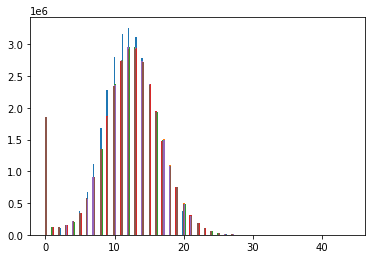

In [14]:
arr_avg_cov=calculate_avg_thr('/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/30mil_sim')

In [15]:
print(arr_avg_cov)

[array([11.88]), array([11.78666667]), array([12.]), array([11.73333333]), array([12.92]), array([11.9])]


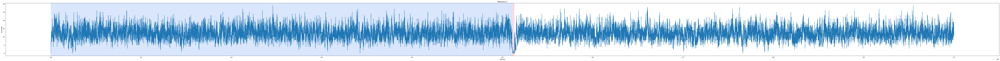

Sample:3, running time: 
7.013647794723511


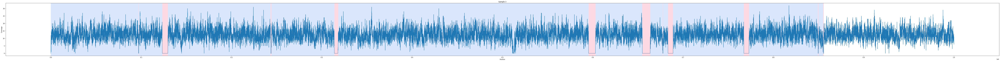

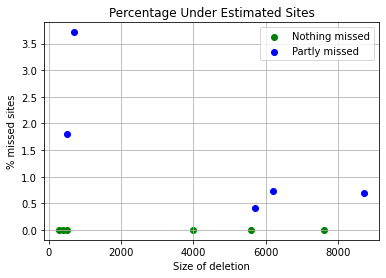

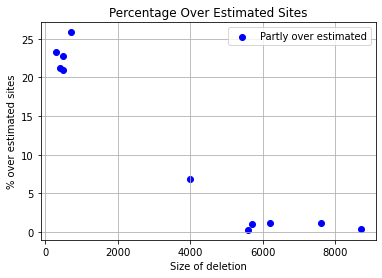

accuracy, sensitivity, specificity
(0.998737, 0.9959203980099502, 0.9988549697853719)
Sample:4, running time: 
6.9913060665130615


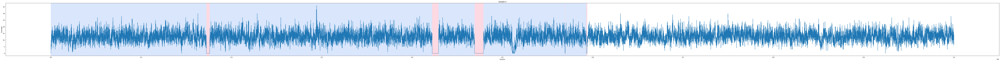

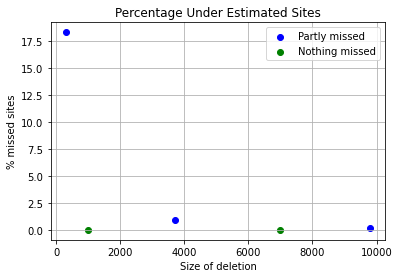

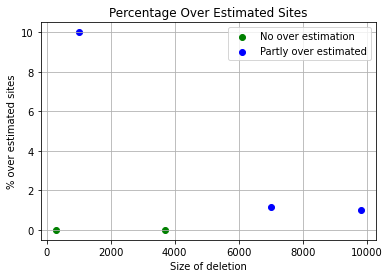

accuracy, sensitivity, specificity
(0.99961, 0.994954128440367, 0.9997137599672868)
Sample:5, running time: 
7.037996053695679


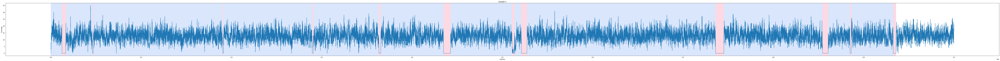

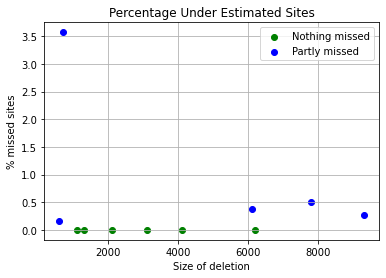

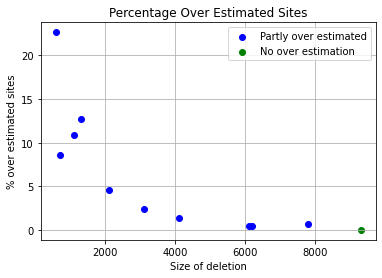

accuracy, sensitivity, specificity
(0.999079, 0.9973349056603774, 0.999156223893066)
Sample:6, running time: 
6.974838972091675


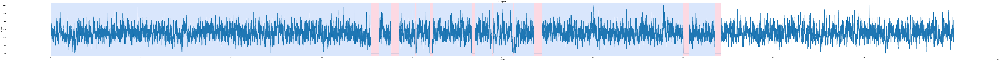

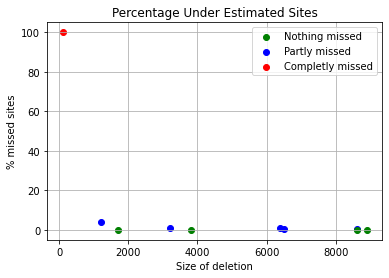

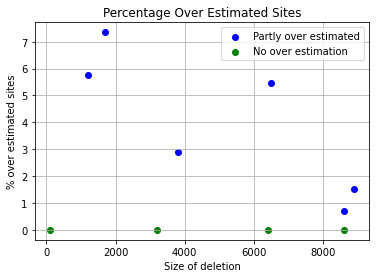

accuracy, sensitivity, specificity
(0.997382, 0.9938979591836735, 0.9975615141955836)
Sample:7, running time: 
7.032078981399536


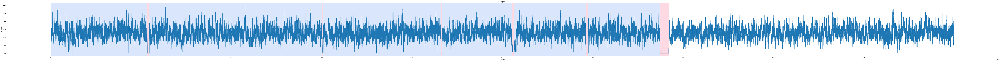

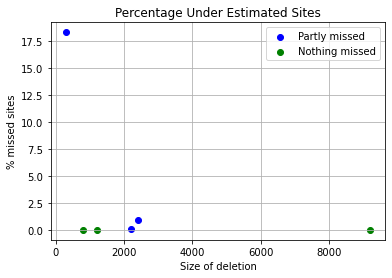

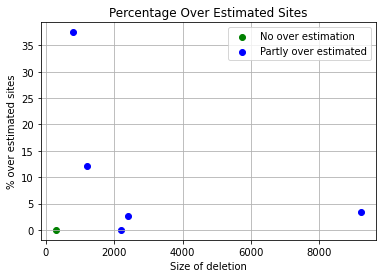

accuracy, sensitivity, specificity
(0.999092, 0.9950931677018634, 0.9991574346986483)


In [68]:
predict_deletions_bottomUp(path, "PA_chr01", 10**4, 10**4, arr_avg_cov,[2], "bu_p10e4")


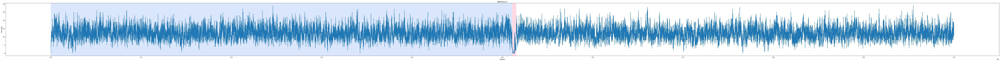

Sample:3, running time: 
7.052906036376953


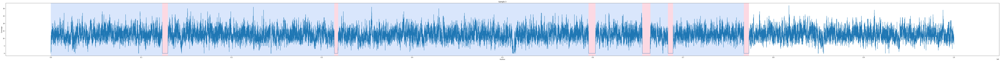

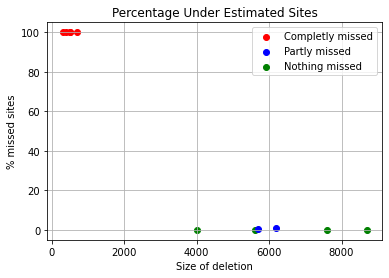

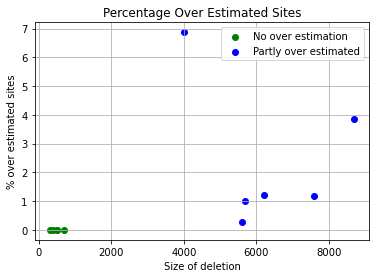

accuracy, sensitivity, specificity
(0.996684, 0.9386069651741293, 0.9991164826005418)
Sample:4, running time: 
6.960978269577026


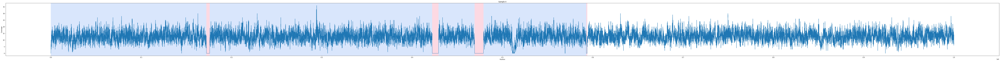

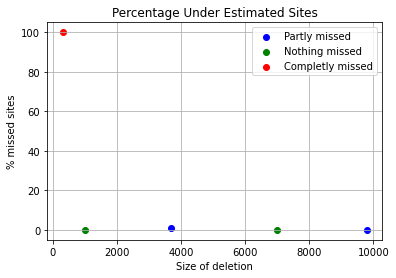

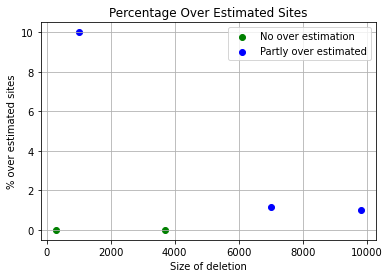

accuracy, sensitivity, specificity
(0.999365, 0.9837155963302753, 0.9997137599672868)
Sample:5, running time: 
7.071156024932861


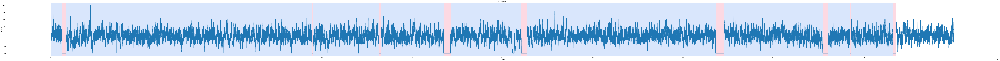

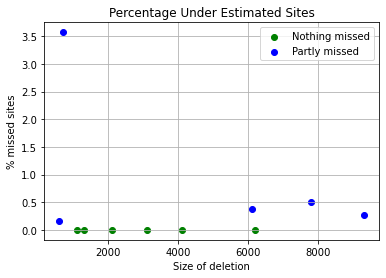

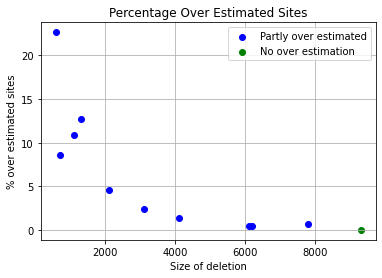

accuracy, sensitivity, specificity
(0.999079, 0.9973349056603774, 0.999156223893066)
Sample:6, running time: 
7.016798973083496


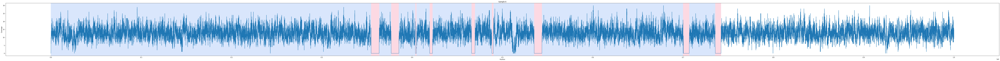

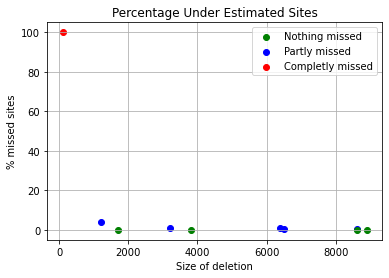

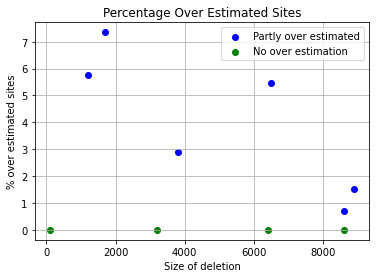

accuracy, sensitivity, specificity
(0.998847, 0.9938979591836735, 0.9991019978969505)
Sample:7, running time: 
7.08107590675354


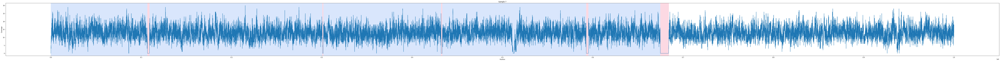

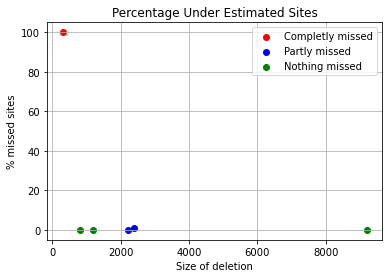

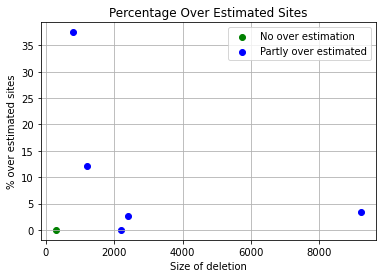

accuracy, sensitivity, specificity
(0.998847, 0.9798757763975156, 0.9991574346986483)


In [69]:
predict_deletions_bottomUp(path, "PA_chr01", 10**5, 10**5, arr_avg_cov,[2], "bu_p10e5")


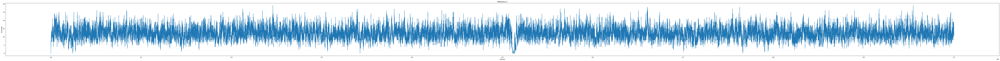

Sample:3, running time: 
7.013697862625122


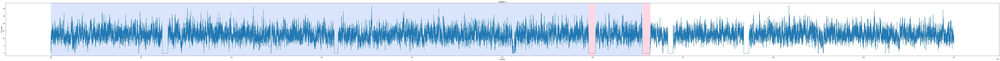

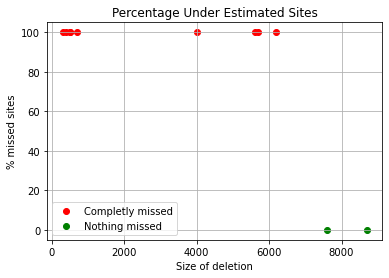

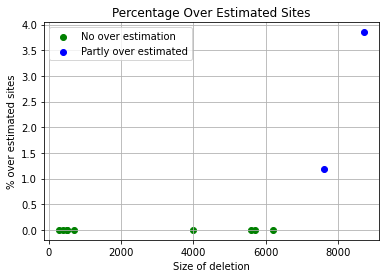

accuracy, sensitivity, specificity
(0.975675, 0.4054726368159204, 0.9995571994165451)
Sample:4, running time: 
7.012327194213867


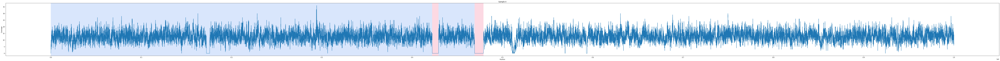

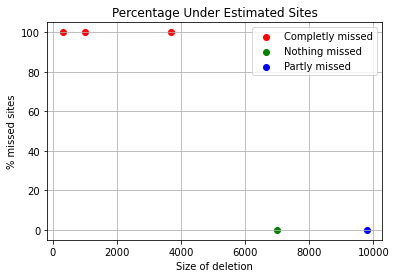

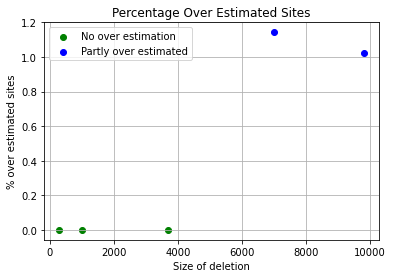

accuracy, sensitivity, specificity
(0.9948, 0.7697247706422018, 0.9998159885503987)
Sample:5, running time: 
7.052762985229492


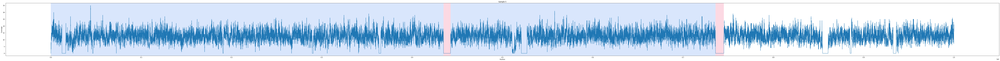

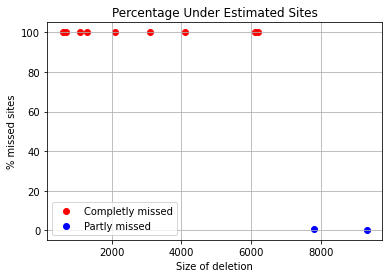

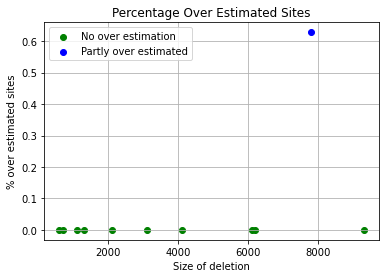

accuracy, sensitivity, specificity
(0.974587, 0.40179245283018866, 0.9999488304093567)
Sample:6, running time: 
7.017802953720093


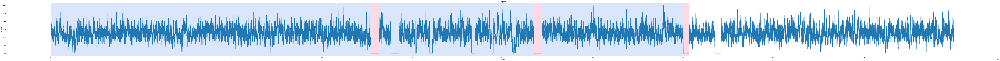

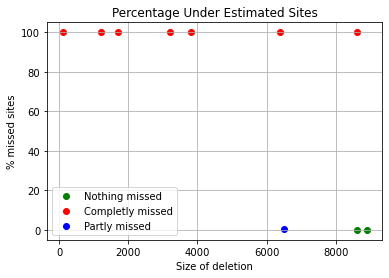

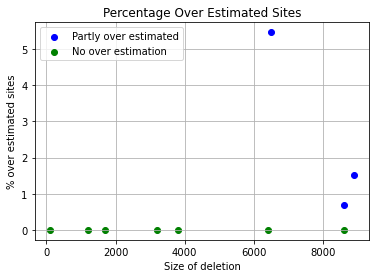

accuracy, sensitivity, specificity
(0.974435, 0.48948979591836733, 0.9994216614090431)
Sample:7, running time: 
7.022824048995972


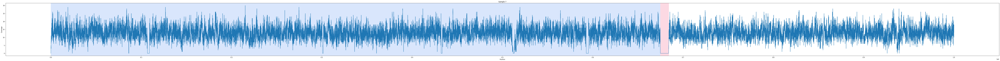

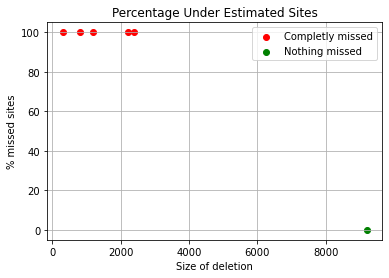

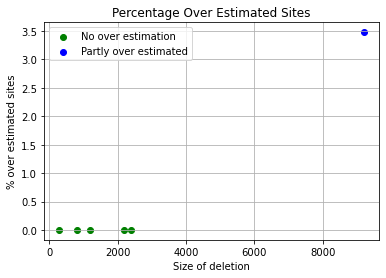

accuracy, sensitivity, specificity
(0.99278, 0.5714285714285714, 0.9996747636954975)


In [70]:
predict_deletions_bottomUp(path, "PA_chr01", 10**6, 10**6, arr_avg_cov,[2], "bu_p10e6")


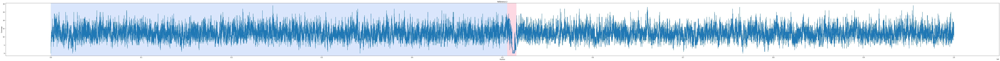

[8.84]
Sample:3, running time: 
10.519134998321533


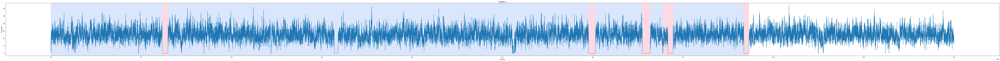

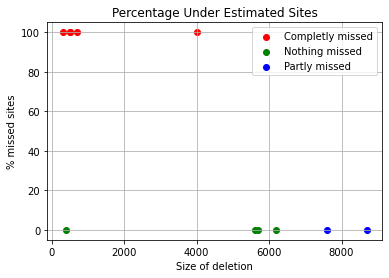

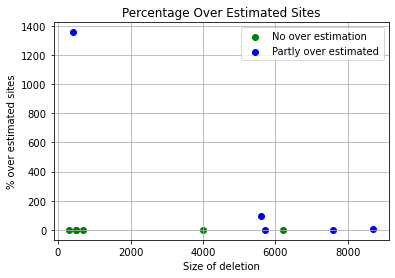

accuracy, sensitivity, specificity
(0.988171, 0.8506965174129353, 0.993928943529902)
[9.]
Sample:4, running time: 
10.642442226409912


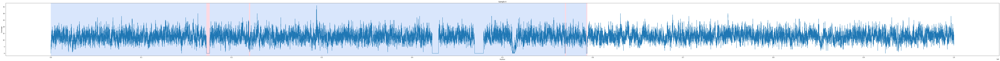

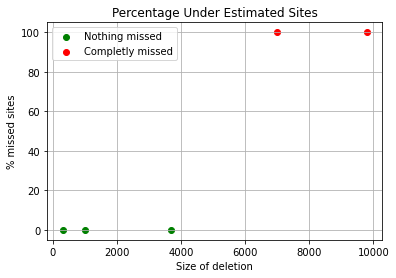

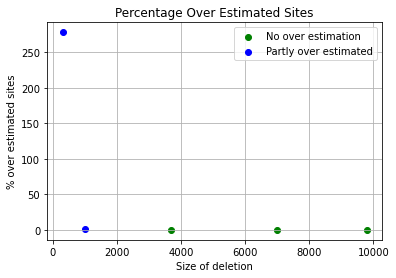

accuracy, sensitivity, specificity
(0.981055, 0.22935779816513763, 0.9978071968922511)
[8.8]
Sample:5, running time: 
11.148234128952026


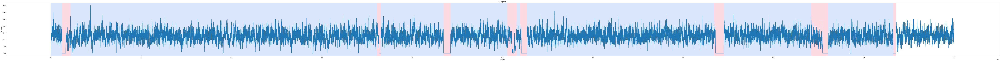

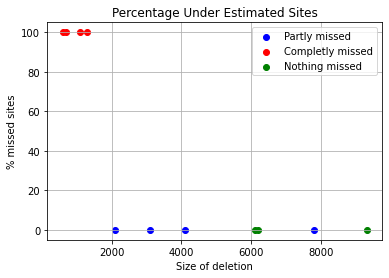

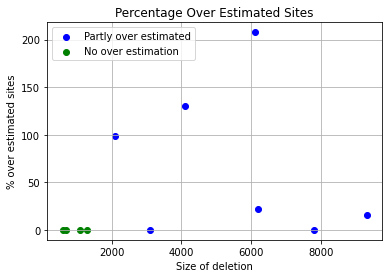

accuracy, sensitivity, specificity
(0.973391, 0.9125707547169811, 0.9760839598997494)
[9.69]
Sample:6, running time: 
10.24392294883728


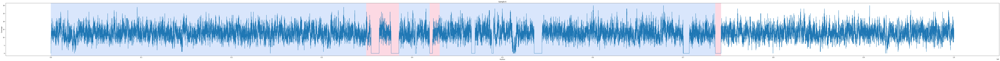

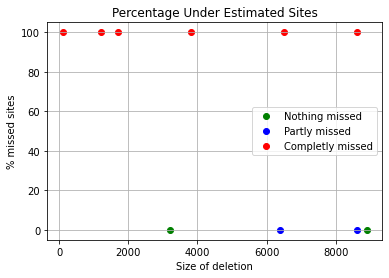

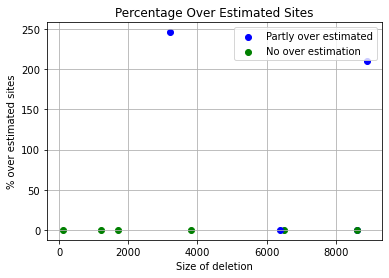

accuracy, sensitivity, specificity
(0.951534, 0.553, 0.972068349106204)
[8.925]
Sample:7, running time: 
10.909160137176514


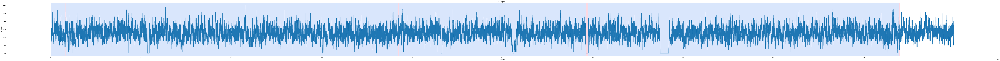

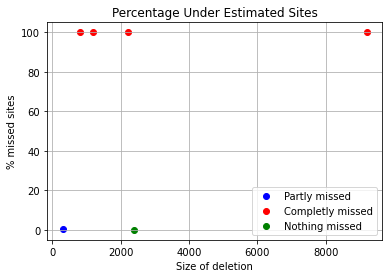

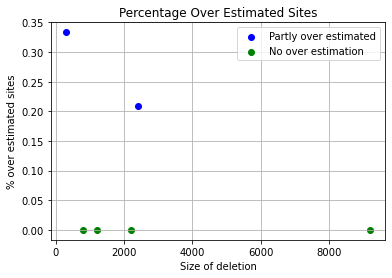

accuracy, sensitivity, specificity
(0.985403, 0.16763975155279504, 0.9987844293119219)


In [81]:
predict_deletions_window(path, "PA_chr01", 1, 1, 50, arr_avg_cov,[2], "bu_p1w50")


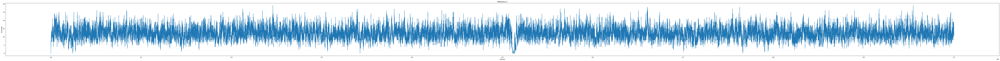

[8.84]
Sample:3, running time: 
10.444339990615845


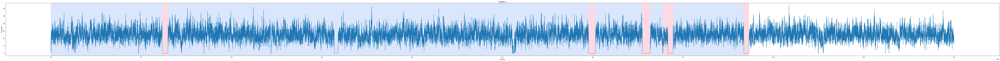

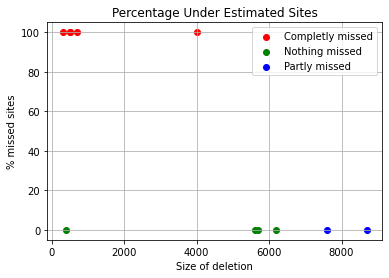

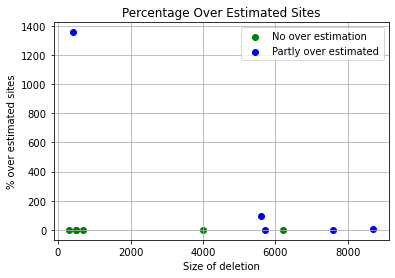

accuracy, sensitivity, specificity
(0.988171, 0.8506965174129353, 0.993928943529902)
[9.]
Sample:4, running time: 
10.343549966812134


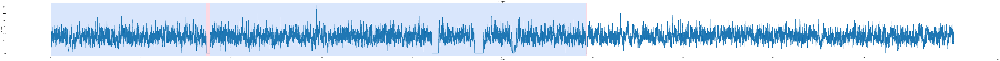

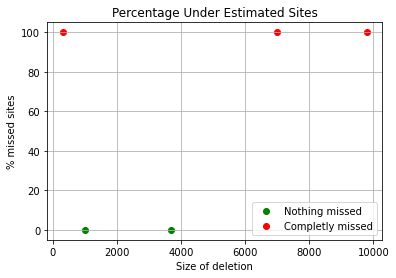

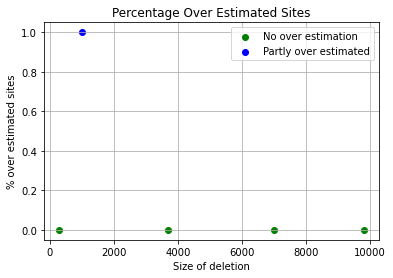

accuracy, sensitivity, specificity
(0.98289, 0.21559633027522937, 0.9999897771416888)
[8.8]
Sample:5, running time: 
10.795923948287964


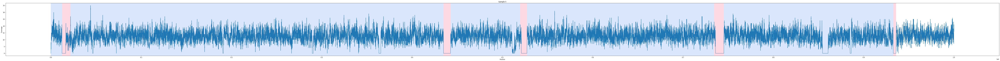

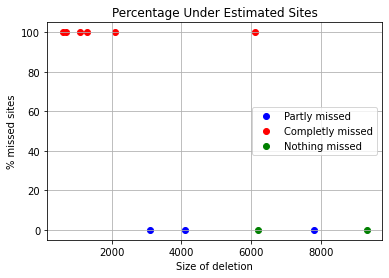

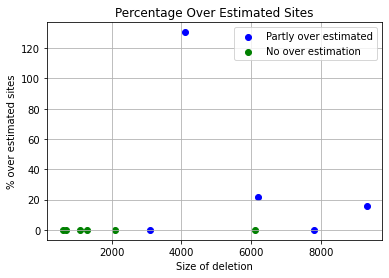

accuracy, sensitivity, specificity
(0.979942, 0.7192452830188679, 0.991484962406015)
[9.69]
Sample:6, running time: 
10.110901355743408


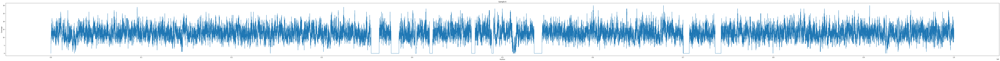

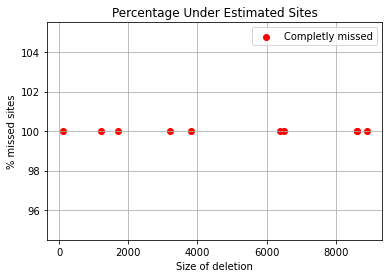

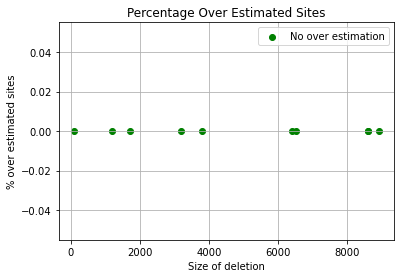

accuracy, sensitivity, specificity
(0.951, 0.0, 1.0)
[8.925]
Sample:7, running time: 
10.788825988769531


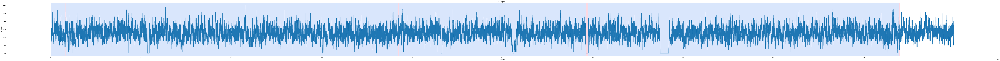

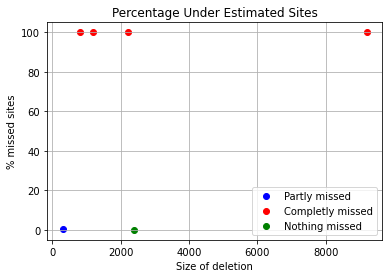

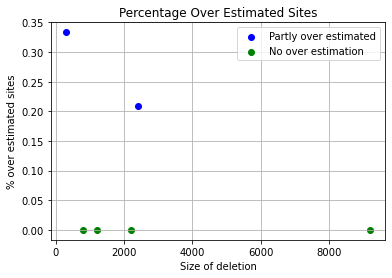

accuracy, sensitivity, specificity
(0.985403, 0.16763975155279504, 0.9987844293119219)


In [82]:
predict_deletions_window(path, "PA_chr01", 5, 5, 50, arr_avg_cov,[2], "bu_p5w50")


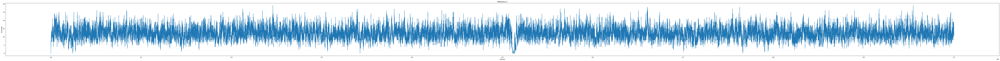

[8.84]
Sample:3, running time: 
10.414001941680908


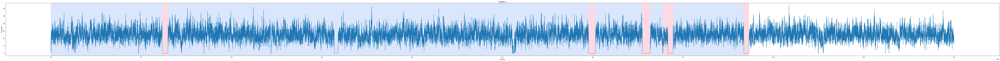

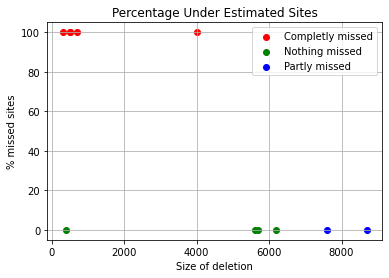

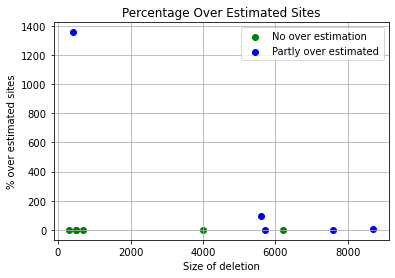

accuracy, sensitivity, specificity
(0.988171, 0.8506965174129353, 0.993928943529902)
[9.]
Sample:4, running time: 
10.499686241149902


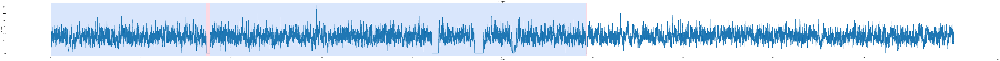

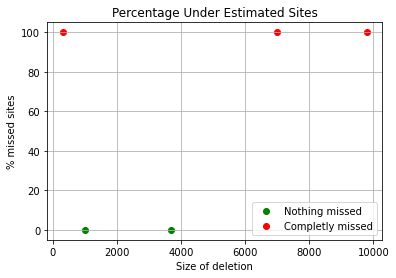

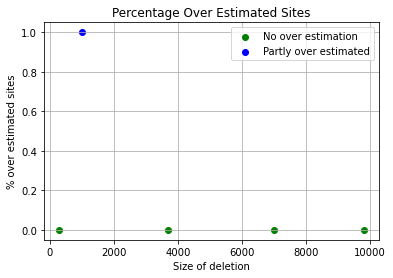

accuracy, sensitivity, specificity
(0.98289, 0.21559633027522937, 0.9999897771416888)
[8.8]
Sample:5, running time: 
10.131168127059937


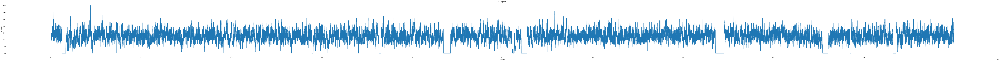

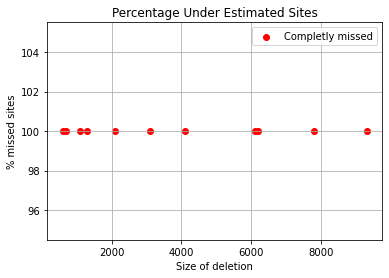

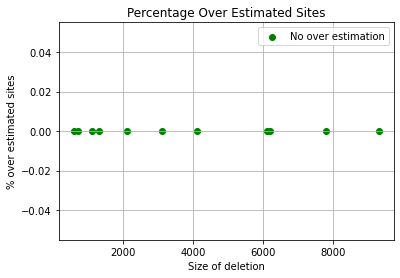

accuracy, sensitivity, specificity
(0.9576, 0.0, 1.0)
[9.69]
Sample:6, running time: 
10.072547912597656


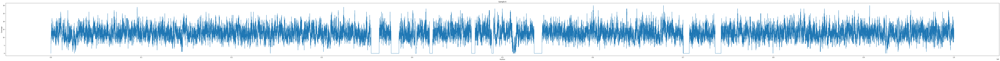

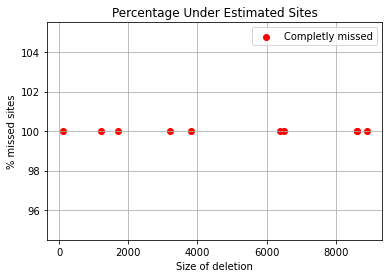

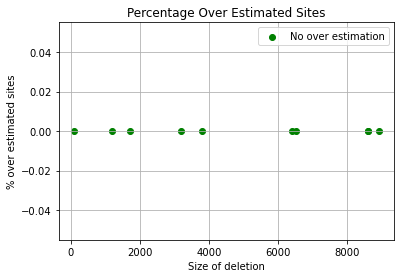

accuracy, sensitivity, specificity
(0.951, 0.0, 1.0)
[8.925]
Sample:7, running time: 
10.18661904335022


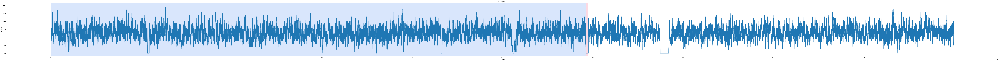

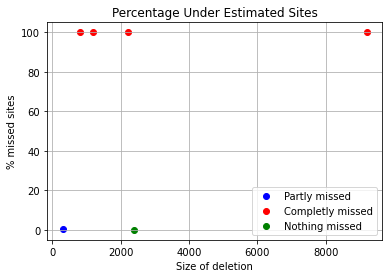

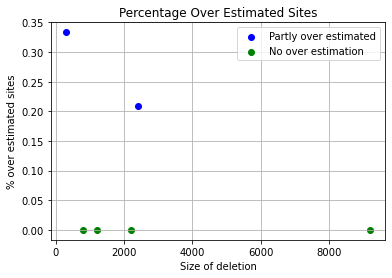

accuracy, sensitivity, specificity
(0.986593, 0.16763975155279504, 0.9999939018192906)


In [83]:
predict_deletions_window(path, "PA_chr01", 10, 10, 50, arr_avg_cov,[2], "bu_p10w50")


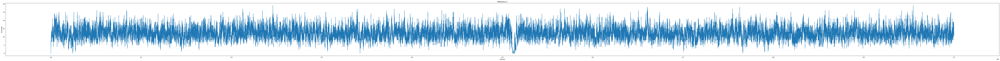

[8.84]
Sample:3, running time: 
10.296164989471436


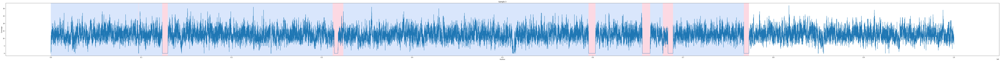

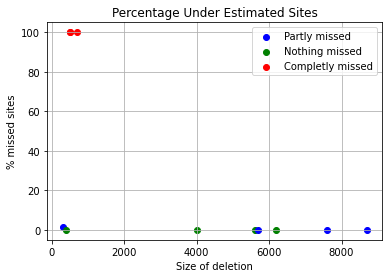

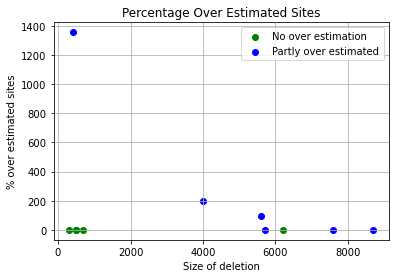

accuracy, sensitivity, specificity
(0.98472, 0.9574626865671642, 0.9858616378412169)
[9.]
Sample:4, running time: 
10.01608395576477


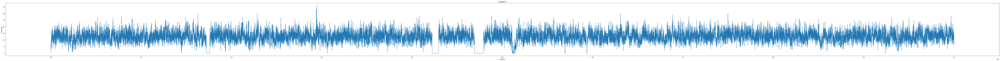

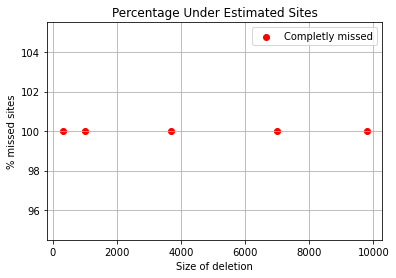

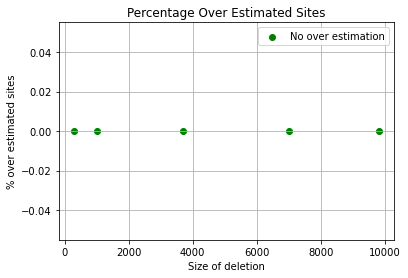

accuracy, sensitivity, specificity
(0.9782, 0.0, 1.0)
[8.8]
Sample:5, running time: 
10.028963804244995


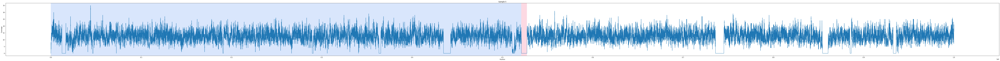

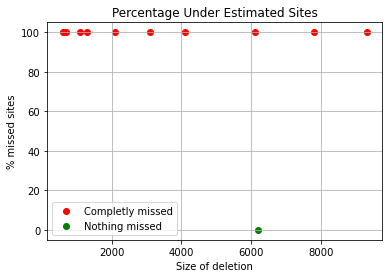

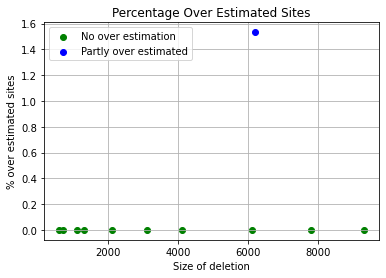

accuracy, sensitivity, specificity
(0.963705, 0.14622641509433962, 0.9999007936507937)
[9.69]
Sample:6, running time: 
10.282751083374023


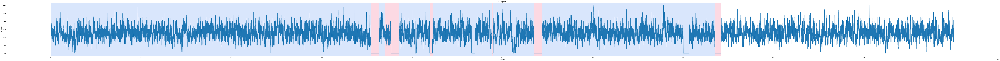

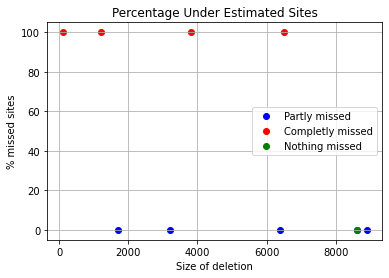

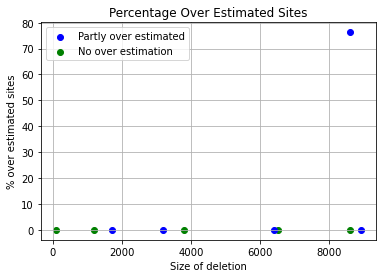

accuracy, sensitivity, specificity
(0.981826, 0.7631224489795918, 0.9930946372239747)
[8.925]
Sample:7, running time: 
14.149091005325317


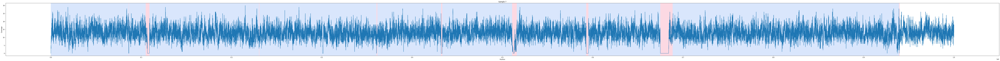

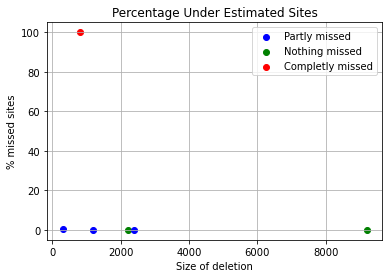

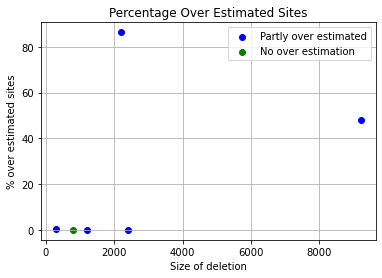

accuracy, sensitivity, specificity
(0.985622, 0.9500621118012422, 0.986203882508385)


In [84]:
predict_deletions_window(path, "PA_chr01", 1, 1, 10, arr_avg_cov,[2], "bu_p1w10")


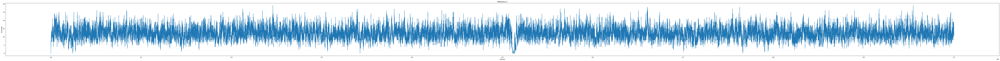

[8.84]
Sample:3, running time: 
10.320918083190918


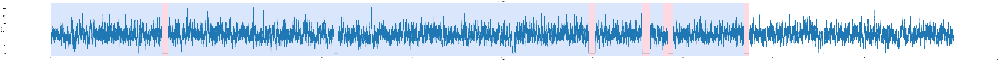

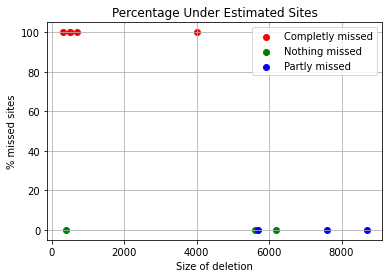

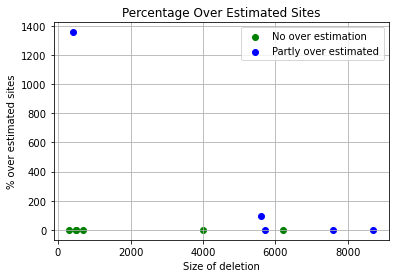

accuracy, sensitivity, specificity
(0.98839, 0.8506218905472637, 0.9941602417170243)
[9.]
Sample:4, running time: 
10.693264245986938


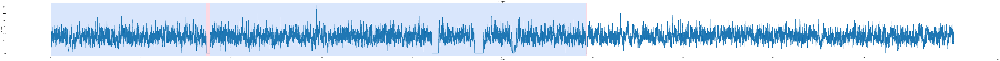

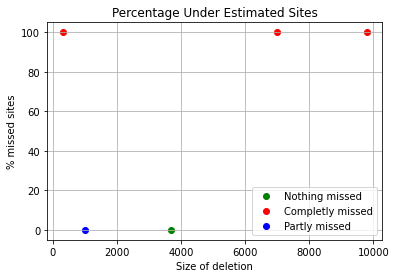

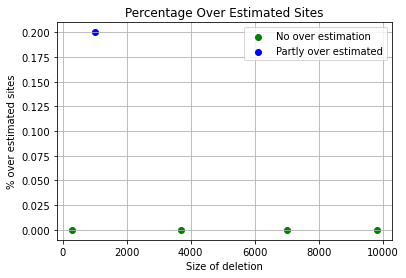

accuracy, sensitivity, specificity
(0.982896, 0.2155045871559633, 0.9999979554283378)
[8.8]
Sample:5, running time: 
10.604866981506348


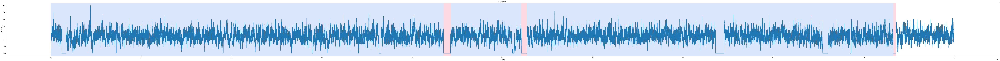

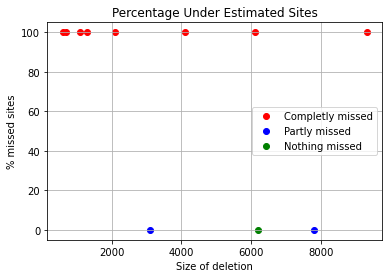

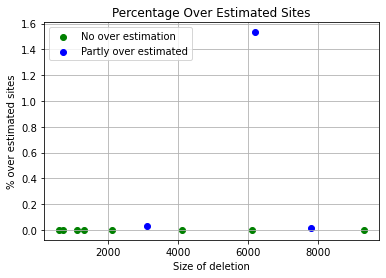

accuracy, sensitivity, specificity
(0.974601, 0.4032547169811321, 0.9998987050960735)
[9.69]
Sample:6, running time: 
10.47599720954895


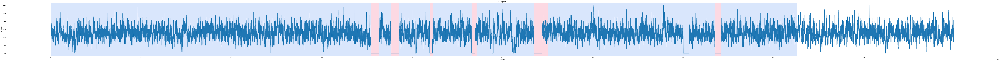

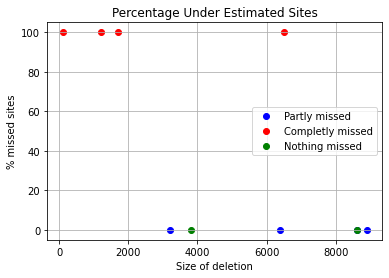

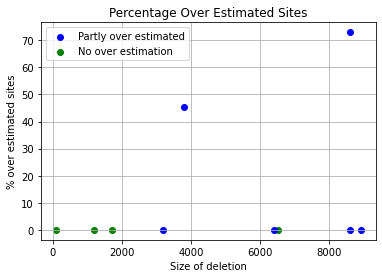

accuracy, sensitivity, specificity
(0.982228, 0.806, 0.9913080967402734)
[8.925]
Sample:7, running time: 
10.64556884765625


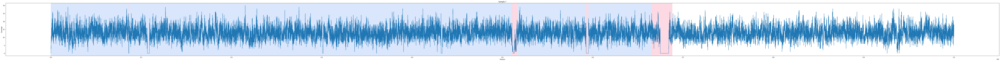

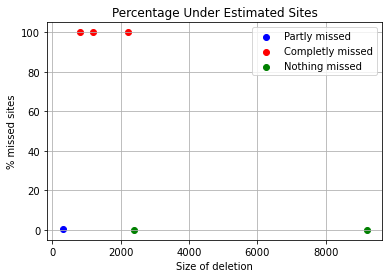

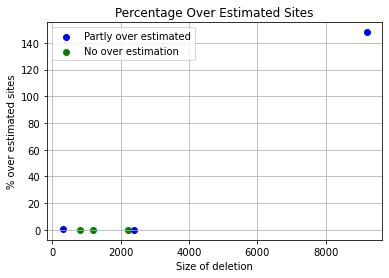

accuracy, sensitivity, specificity
(0.976148, 0.7390683229813665, 0.9800274418131923)


In [85]:
predict_deletions_window(path, "PA_chr01", 1, 1, 25, arr_avg_cov,[2], "bu_p1w25")


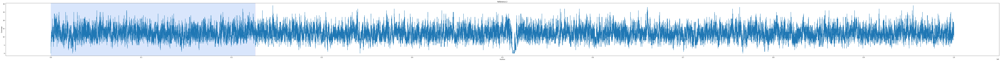

[8.84]
Sample:3, running time: 
12.103492975234985


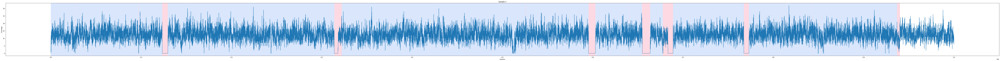

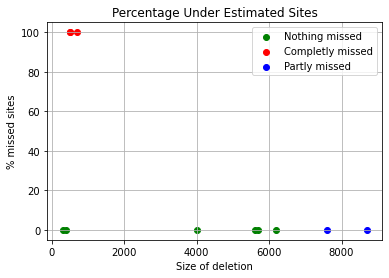

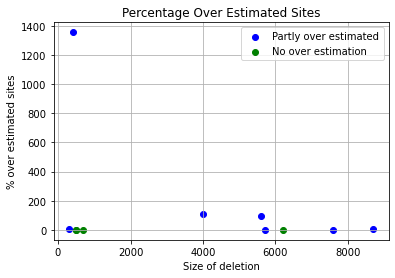

accuracy, sensitivity, specificity
(0.984201, 0.9576616915422885, 0.9853125651177329)
[9.]
Sample:4, running time: 
11.740256309509277


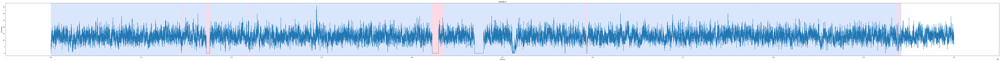

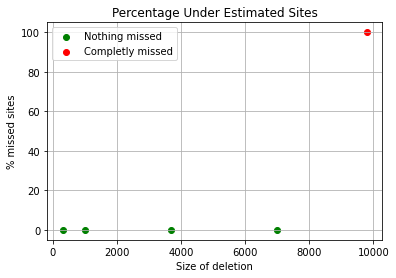

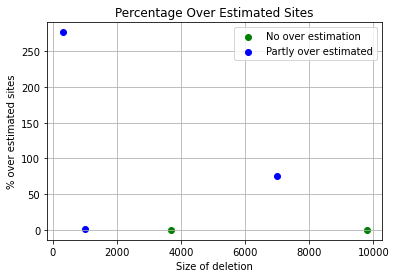

accuracy, sensitivity, specificity
(0.978945, 0.5504587155963303, 0.9884941729707626)
[8.8]
Sample:5, running time: 
11.033198833465576


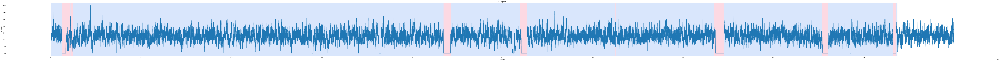

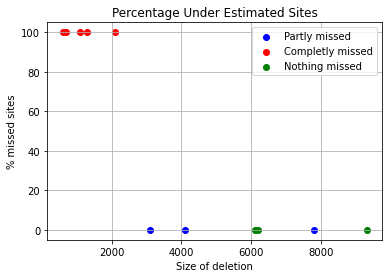

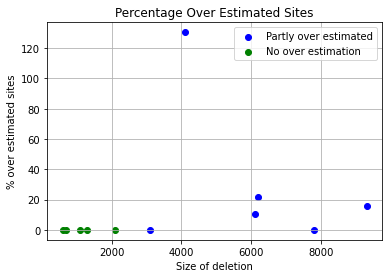

accuracy, sensitivity, specificity
(0.981537, 0.8631132075471698, 0.9867804928989139)
[9.69]
Sample:6, running time: 
10.299282789230347


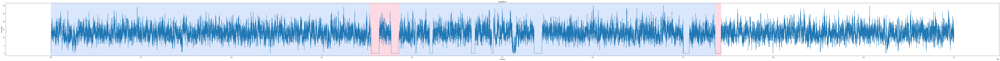

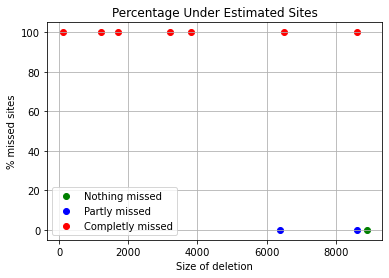

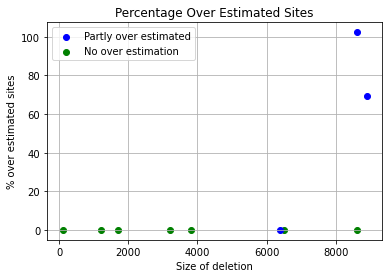

accuracy, sensitivity, specificity
(0.959944, 0.4876938775510204, 0.9842765509989485)
[8.925]
Sample:7, running time: 
10.925002098083496


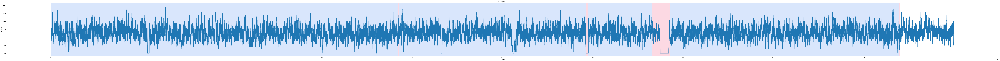

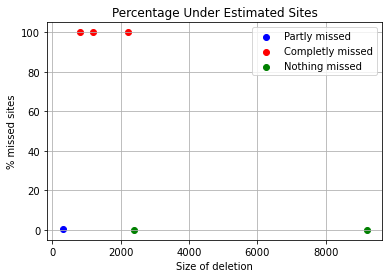

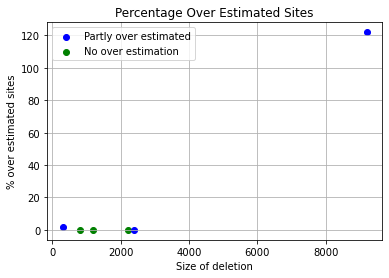

accuracy, sensitivity, specificity
(0.983073, 0.7390683229813665, 0.9870657587153165)


In [87]:
predict_deletions_window(path, "PA_chr01", 1, 1, 100, arr_avg_cov,[2], "bu_p1w100")


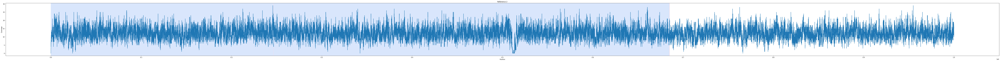

[8.84]
Sample:3, running time: 
10.813158750534058


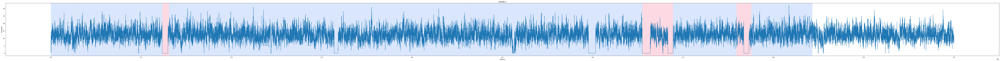

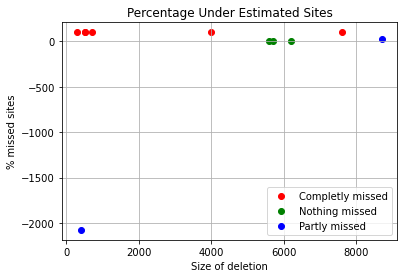

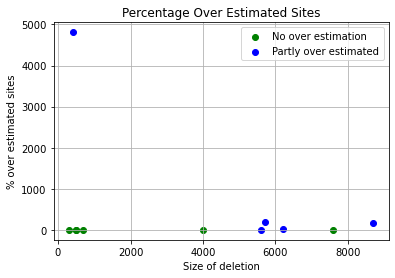

accuracy, sensitivity, specificity
(0.95459, 0.6616915422885572, 0.9668576786830589)
[9.]
Sample:4, running time: 
10.498202323913574


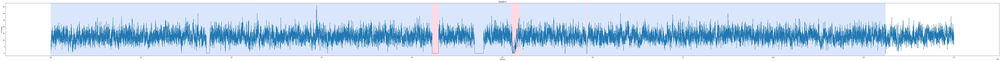

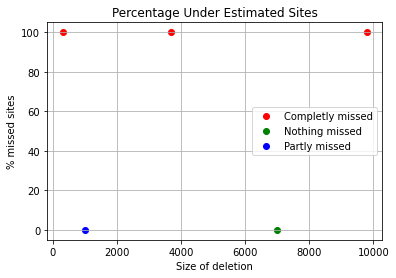

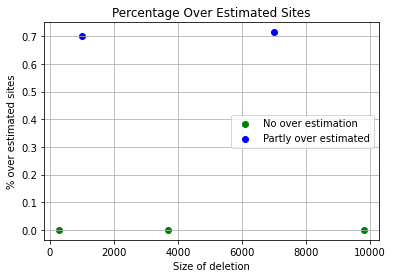

accuracy, sensitivity, specificity
(0.976216, 0.36688073394495413, 0.9897955428337764)
[8.8]
Sample:5, running time: 
11.36457085609436


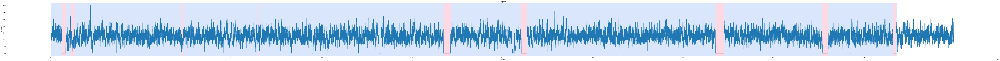

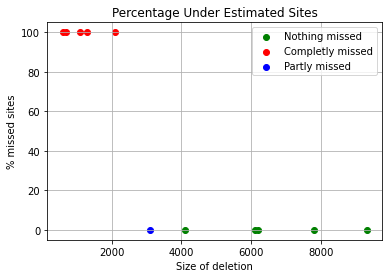

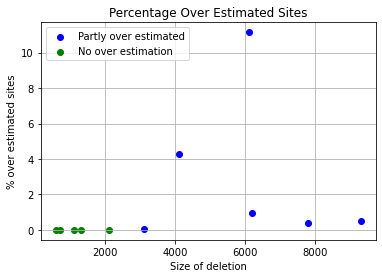

accuracy, sensitivity, specificity
(0.985273, 0.863183962264151, 0.9906787802840434)
[9.69]
Sample:6, running time: 
11.256862163543701


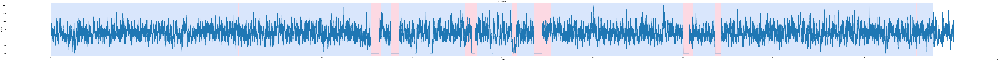

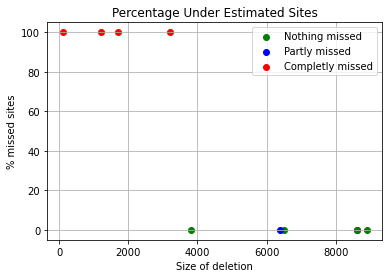

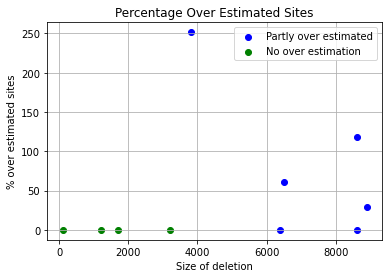

accuracy, sensitivity, specificity
(0.959849, 0.8734081632653061, 0.9643028391167192)
[8.925]
Sample:7, running time: 
10.334129333496094


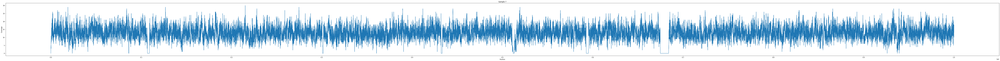

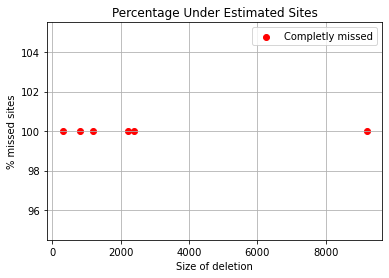

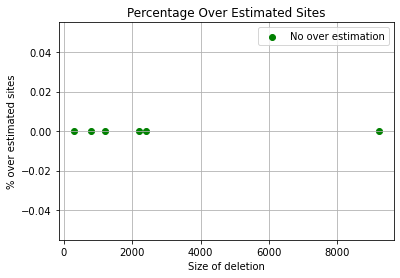

accuracy, sensitivity, specificity
(0.9839, 0.0, 1.0)


In [88]:
predict_deletions_window(path, "PA_chr01", 1, 1, 200, arr_avg_cov,[2], "bu_p1w200")

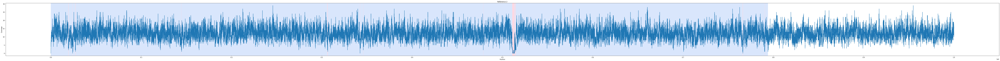

[1.768]
Sample:3, running time: 
19.712872982025146


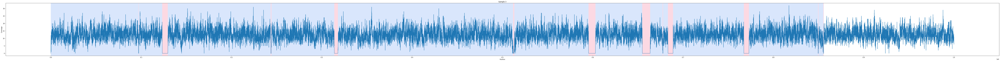

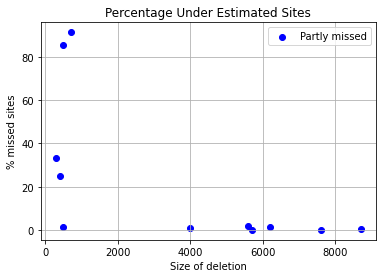

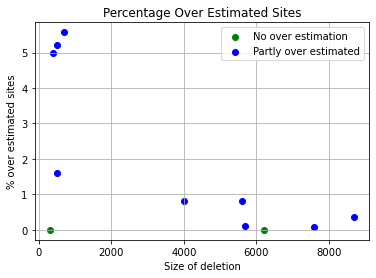

accuracy, sensitivity, specificity
(0.99817, 0.9896766169154229, 0.9985257345280266)
[1.8]
Sample:4, running time: 
16.638816833496094


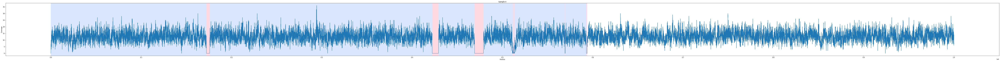

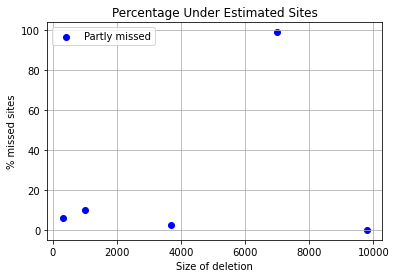

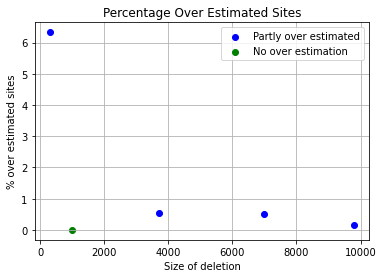

accuracy, sensitivity, specificity
(0.997922, 0.9913302752293578, 0.9980689020650174)
[1.76]
Sample:5, running time: 
19.96562886238098


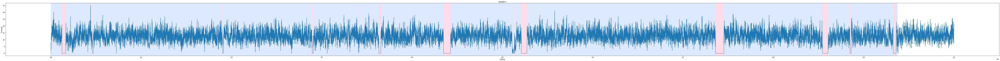

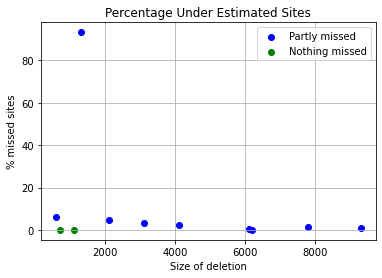

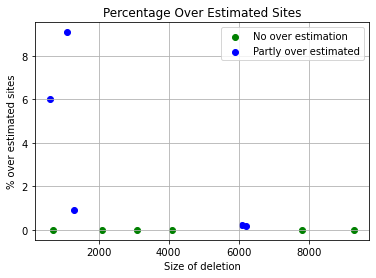

accuracy, sensitivity, specificity
(0.997758, 0.9865330188679245, 0.9982550125313283)
[1.938]
Sample:6, running time: 
21.264160871505737


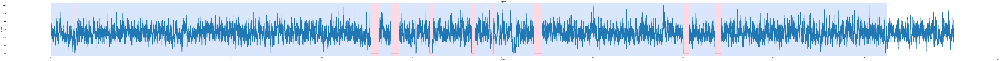

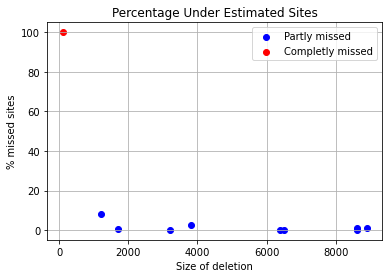

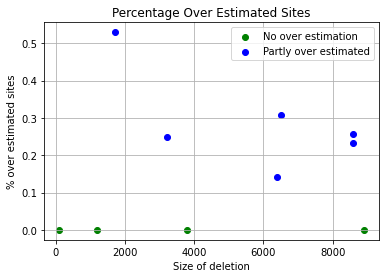

accuracy, sensitivity, specificity
(0.997524, 0.9900408163265306, 0.9979095688748686)
[1.785]
Sample:7, running time: 
16.41605567932129


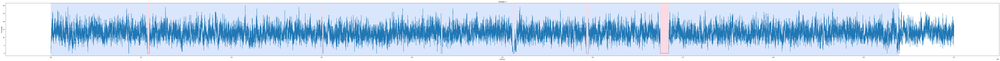

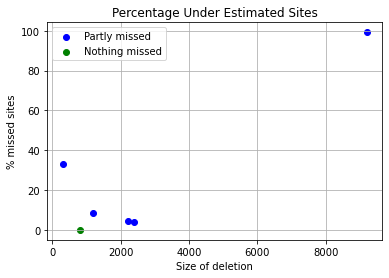

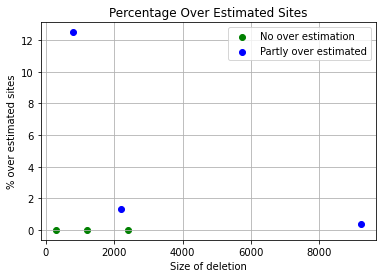

accuracy, sensitivity, specificity
(0.997472, 0.9773913043478261, 0.9978005894908019)


In [100]:
predict_deletions_pelt(path, "PA_chr01", 100, 100, 100, arr_avg_cov,[2], "pelt_p100")

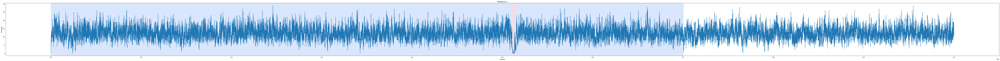

[1.768]
Sample:3, running time: 
13.677200078964233


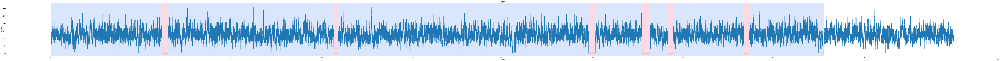

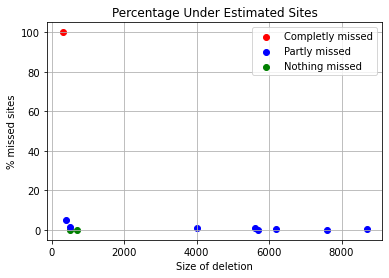

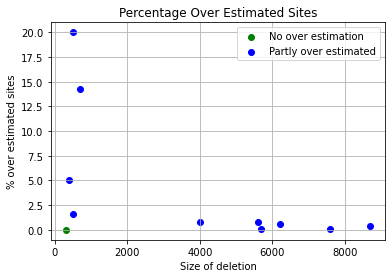

accuracy, sensitivity, specificity
(0.99792, 0.9878109452736319, 0.9983434048760158)
[1.8]
Sample:4, running time: 
12.333120822906494


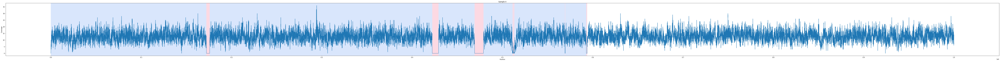

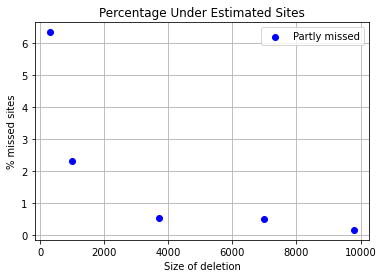

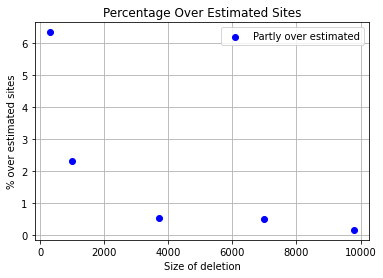

accuracy, sensitivity, specificity
(0.998176, 0.9948623853211009, 0.9982498466571254)
[1.76]
Sample:5, running time: 
13.807535886764526


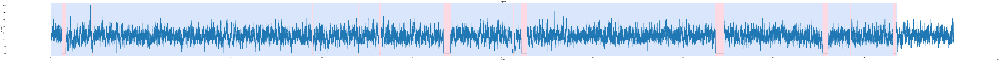

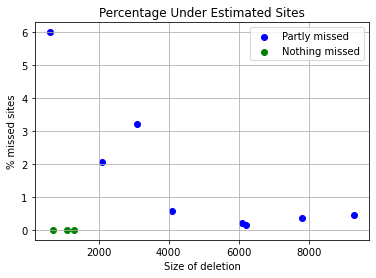

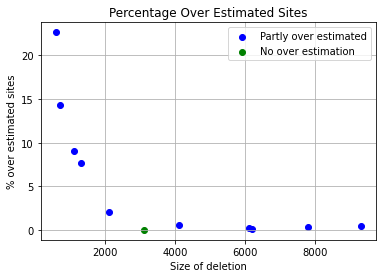

accuracy, sensitivity, specificity
(0.998006, 0.992995283018868, 0.9982278613199665)
[1.938]
Sample:6, running time: 
13.799935102462769


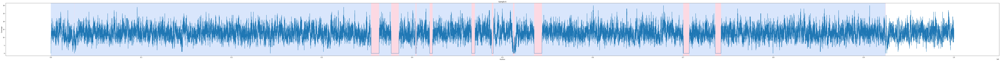

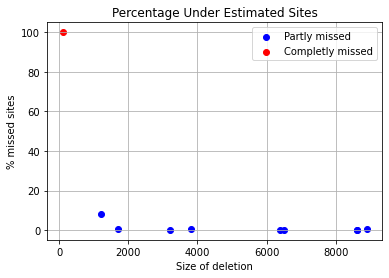

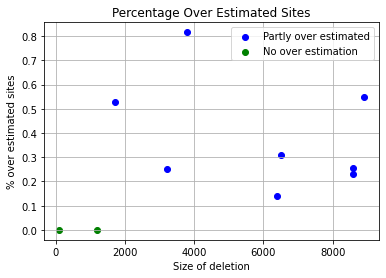

accuracy, sensitivity, specificity
(0.999064, 0.9924897959183674, 0.9994027339642482)
[1.785]
Sample:7, running time: 
13.159328937530518


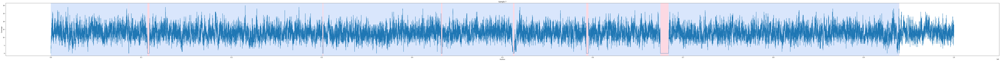

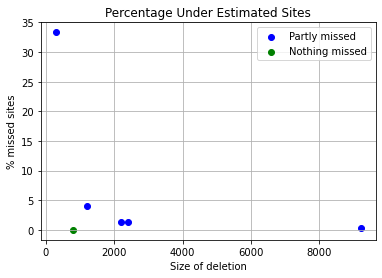

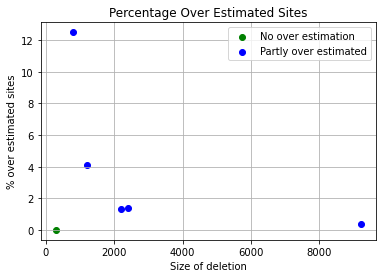

accuracy, sensitivity, specificity
(0.999308, 0.98472049689441, 0.9995467019005997)


In [99]:
predict_deletions_pelt(path, "PA_chr01", 1000, 1000, 100, arr_avg_cov,[2], "pelt_p1000")

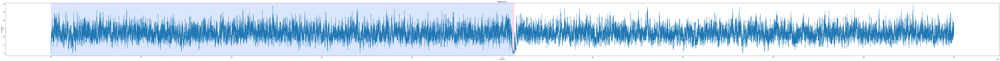

[1.768]
Sample:3, running time: 
22.691601037979126


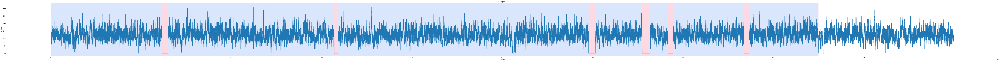

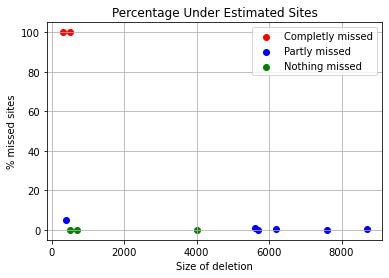

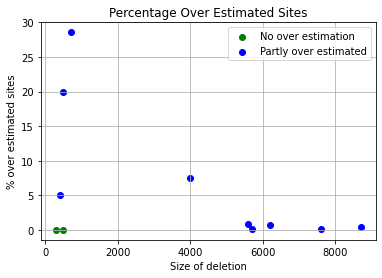

accuracy, sensitivity, specificity
(0.998302, 0.9763930348258707, 0.9992196290893937)
[1.8]
Sample:4, running time: 
25.071994304656982


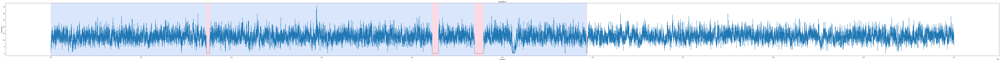

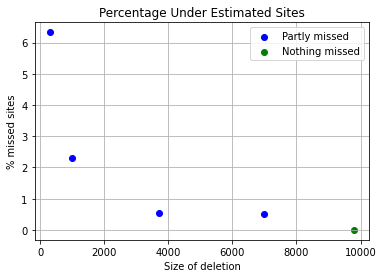

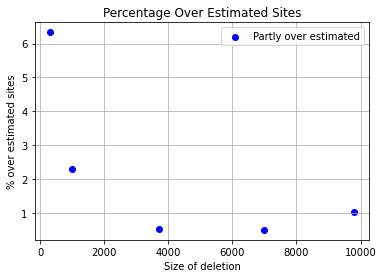

accuracy, sensitivity, specificity
(0.999706, 0.9955504587155963, 0.9997986096912697)
[1.76]
Sample:5, running time: 
26.379804134368896


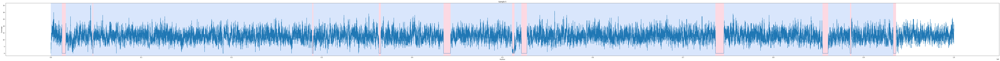

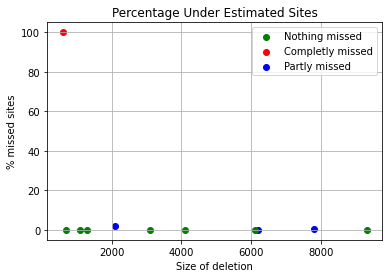

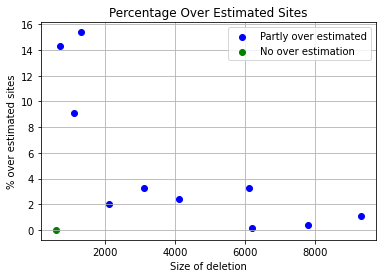

accuracy, sensitivity, specificity
(0.998336, 0.9839150943396227, 0.9989745196324143)
[1.938]
Sample:6, running time: 
23.40366291999817


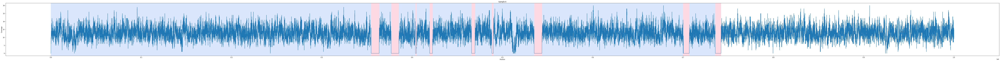

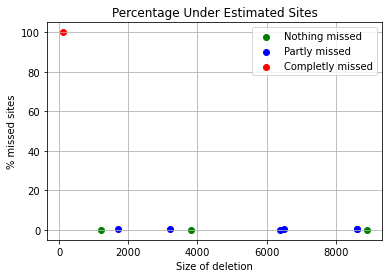

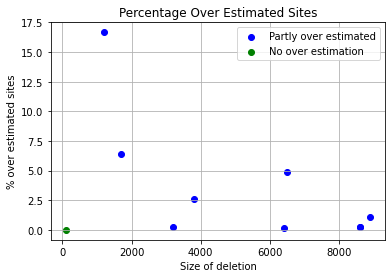

accuracy, sensitivity, specificity
(0.998924, 0.9961632653061224, 0.9990662460567823)
[1.785]
Sample:7, running time: 
28.433276176452637


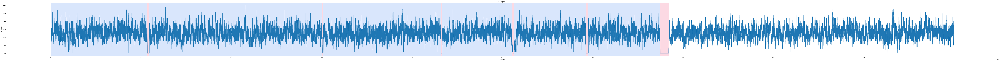

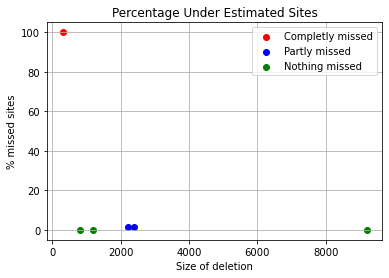

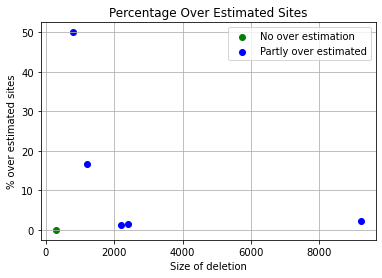

accuracy, sensitivity, specificity
(0.998776, 0.9775155279503106, 0.9991238947047464)


In [101]:
predict_deletions_pelt(path, "PA_chr01", 10000, 10000, 100, arr_avg_cov,[2], "pelt_p10000")

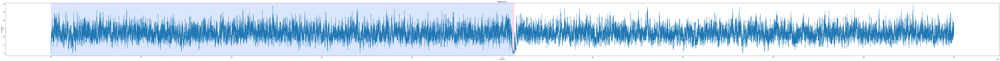

[1.768]
Sample:3, running time: 
17.615705013275146


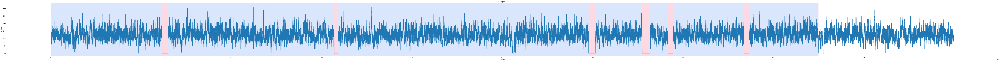

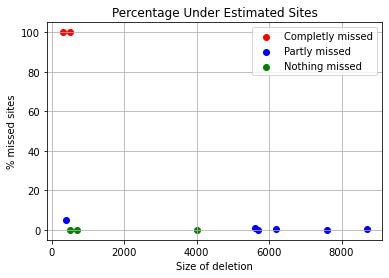

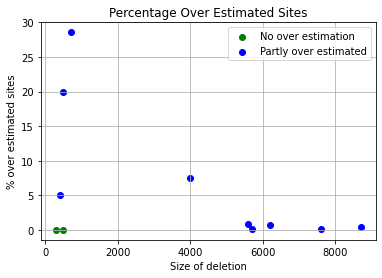

accuracy, sensitivity, specificity
(0.998302, 0.9763930348258707, 0.9992196290893937)
[1.8]
Sample:4, running time: 
25.499953031539917


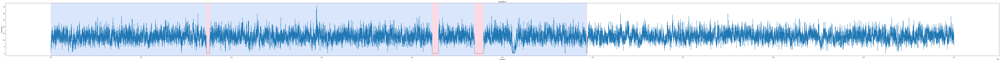

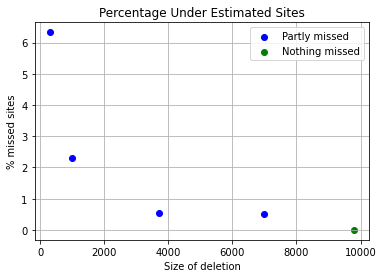

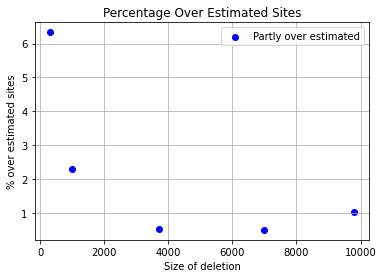

accuracy, sensitivity, specificity
(0.999706, 0.9955504587155963, 0.9997986096912697)
[1.76]
Sample:5, running time: 
26.258925914764404


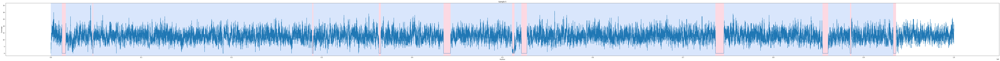

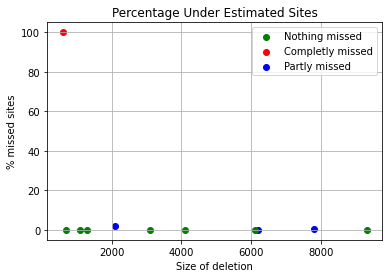

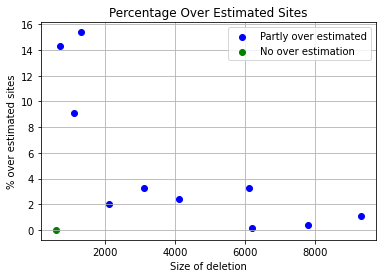

accuracy, sensitivity, specificity
(0.998336, 0.9839150943396227, 0.9989745196324143)
[1.938]
Sample:6, running time: 
23.411430835723877


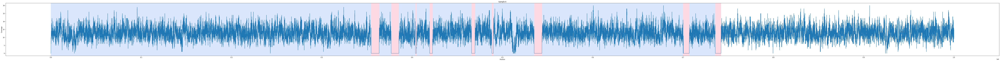

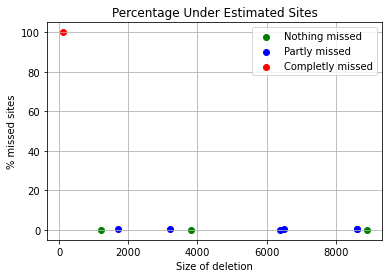

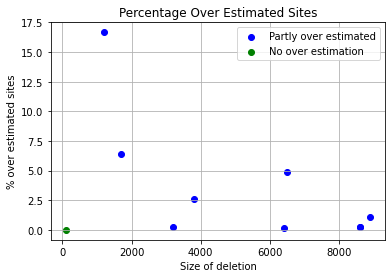

accuracy, sensitivity, specificity
(0.998924, 0.9961632653061224, 0.9990662460567823)
[1.785]
Sample:7, running time: 
28.81739592552185


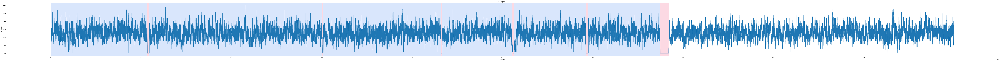

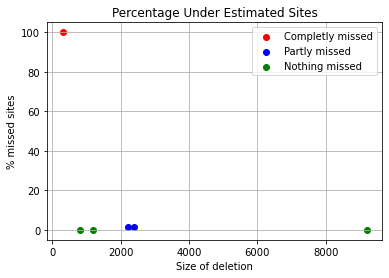

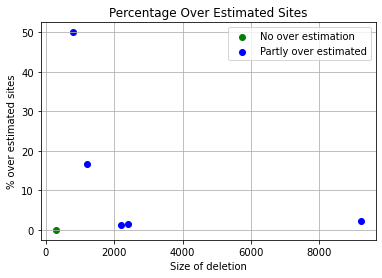

accuracy, sensitivity, specificity
(0.998776, 0.9775155279503106, 0.9991238947047464)


In [102]:
predict_deletions_pelt(path, "PA_chr01", 10**4, 10**4, 100, arr_avg_cov,[2], "pelt_p10e4")

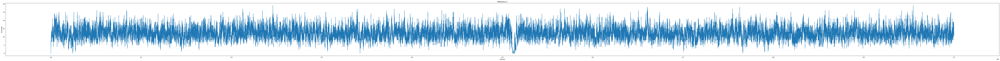

[8.84]
Sample:3, running time: 
10.306956052780151


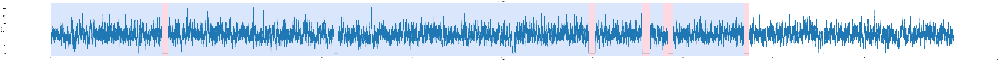

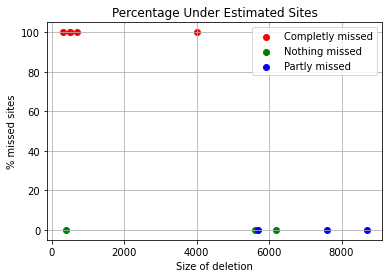

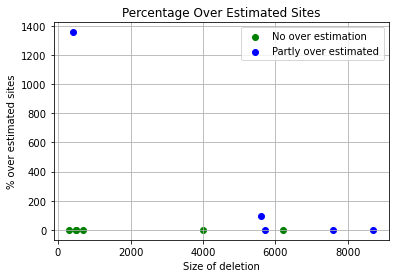

accuracy, sensitivity, specificity
(0.98839, 0.8506218905472637, 0.9941602417170243)
[9.]
Sample:4, running time: 
10.267024040222168


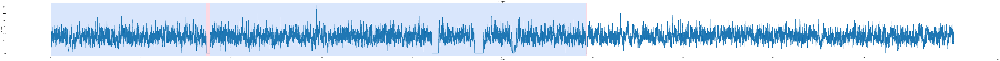

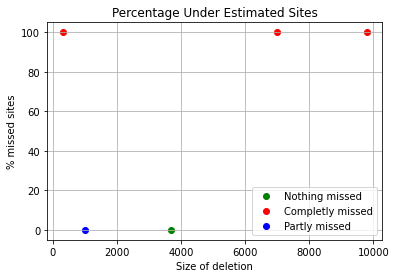

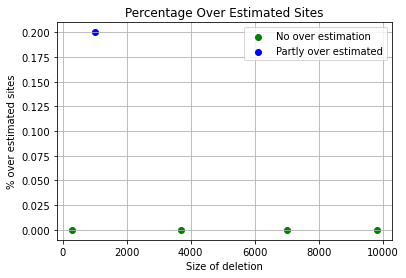

accuracy, sensitivity, specificity
(0.982896, 0.2155045871559633, 0.9999979554283378)
[8.8]
Sample:5, running time: 
10.448924779891968


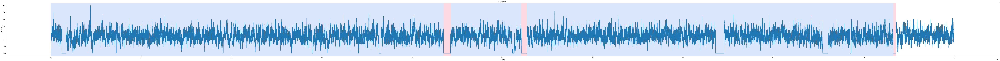

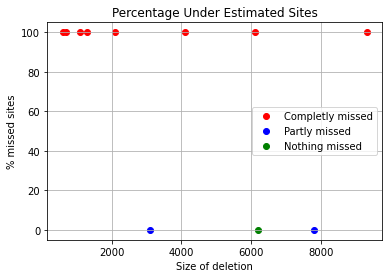

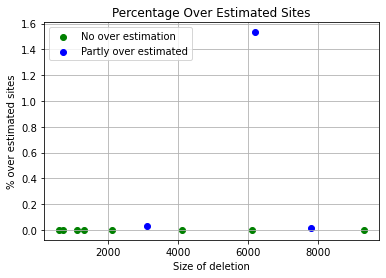

accuracy, sensitivity, specificity
(0.974601, 0.4032547169811321, 0.9998987050960735)
[9.69]
Sample:6, running time: 
11.016888618469238


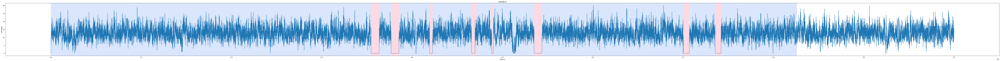

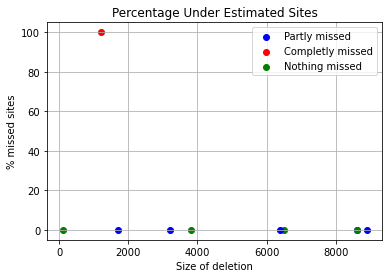

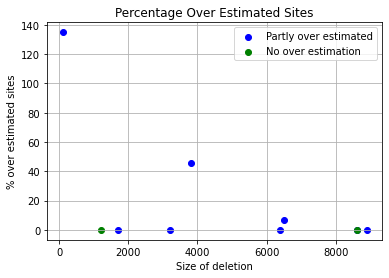

accuracy, sensitivity, specificity
(0.996246, 0.9753673469387755, 0.9973217665615142)
[8.925]
Sample:7, running time: 
10.604300737380981


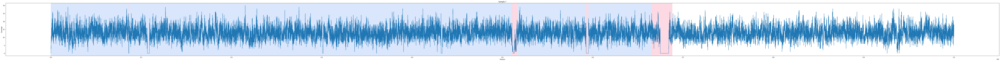

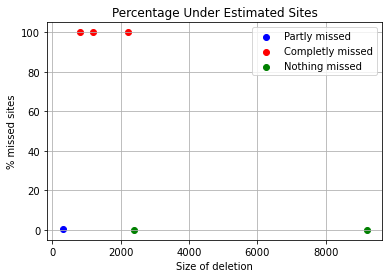

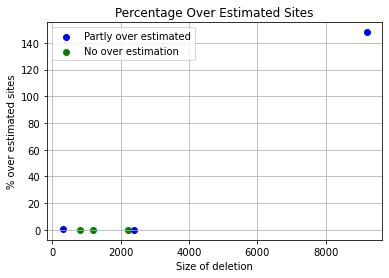

accuracy, sensitivity, specificity
(0.976148, 0.7390683229813665, 0.9800274418131923)


In [103]:
predict_deletions_window(path, "PA_chr01", 0.5, 0.5, 25, arr_avg_cov,[2], "w_p10000")